<a href="https://colab.research.google.com/github/ronybot/NLP_HebrewEmbeding/blob/master/Find_Similarity_ResNet50.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import tensorflow as tf
import numpy as np
import random
import os
import pandas as pd
import matplotlib.pyplot as plt

import random

def get_random_value(not_need, max_value):
    value = random.randint(0, max_value)
    while value == not_need:
        value = random.randint(0, max_value)
    return value


directory = 'data'
file_paths = [os.path.join(directory, file) for file in os.listdir(directory)]
# df = pd.DataFrame({'image': file_names})

def gaussian_blur(image, sigma=1.0):
    # Define a Gaussian kernel
    kernel_size = int(sigma * 3) * 2 + 1  # Make sure the kernel size is odd
    x = tf.range(-kernel_size // 2 + 1, kernel_size // 2 + 1, dtype=tf.float32)
    y = tf.range(-kernel_size // 2 + 1, kernel_size // 2 + 1, dtype=tf.float32)
    x, y = tf.meshgrid(x, y)
    kernel = tf.exp(-(x**2 + y**2) / (2.0 * sigma**2))
    kernel /= tf.reduce_sum(kernel)

    # Apply the Gaussian filter
    image = tf.expand_dims(image, axis=0)  # Add batch dimension
    image = tf.expand_dims(image, axis=-1)  # Add channel dimension
    image = tf.nn.conv2d(image, tf.expand_dims(tf.expand_dims(kernel, axis=-1), axis=-1), strides=[1, 1, 1, 1], padding='SAME')
    image = tf.squeeze(image, axis=[0, -1])  # Remove batch and channel dimensions

    return image

# Function to preprocess and normalize images
def preprocess_main_image(image_path):
    image = tf.io.read_file(image_path)
    image = tf.image.decode_png(image, channels=3)

    image = tf.image.convert_image_dtype(image, tf.float32)  # Convert to float32
    image = tf.image.resize(image, (224, 224))  # Resize to input shape for ResNet50
    return image


def preprocess_flip_image(image_path):
    image = tf.io.read_file(image_path)
    image = tf.image.decode_png(image, channels=3)

    image = tf.image.convert_image_dtype(image, tf.float32)  # Convert to float32
    image = tf.image.resize(image, (224, 224))  # Resize to input shape for ResNet50
    image = tf.image.flip_left_right(image)  # Horizontal flip (left to right)
    return image


def preprocess_rotation_image(image_path):
    image = tf.io.read_file(image_path)
    image = tf.image.decode_png(image, channels=3)

    image = tf.image.convert_image_dtype(image, tf.float32)  # Convert to float32
    image = tf.image.resize(image, (224, 224))  # Resize to input shape for ResNet50

    # Rotate the image randomly
    k = tf.random.uniform(shape=[], minval=1, maxval=4, dtype=tf.int32)  # Randomly choose rotation angle (0, 90, 180, or 270 degrees)
    image = tf.image.rot90(image, k=k)

    return image



def preprocess_gaussian_image(image_path):
    image = tf.io.read_file(image_path)
    image = tf.image.decode_png(image, channels=3)

    image = tf.image.convert_image_dtype(image, tf.float32)  # Convert to float32
    image = tf.image.resize(image, (224, 224))  # Resize to input shape for ResNet50

    # Apply Gaussian blur
    image = gaussian_blur(image, sigma=1)

    return image




# Generate pairs of images and their corresponding labels
def generate_pairs(dataset):
    pairs = []
    labels = []


    for index in range(len(dataset)):
        # Select a random pair of images from the dataset
        image_list=dataset[index]


        image1 = preprocess_main_image(image_list)
        image2 = preprocess_flip_image(image_list)
        label = 1
        pairs.append((image1, image2))
        labels.append(label)


        image1 = preprocess_main_image(image_list)
        image2 = preprocess_rotation_image(image_list)
        label = 1
        pairs.append((image1, image2))
        labels.append(label)



        image1 = preprocess_main_image(image_list)
        image2 = preprocess_gaussian_image(image_list)
        label = 1
        pairs.append((image1, image2))
        labels.append(label)





        max_value=len(dataset)-1

        image1 = preprocess_main_image(image_list)
        image2 = preprocess_main_image(dataset[get_random_value(index, max_value)])
        label = 0
        pairs.append((image1, image2))
        labels.append(label)


        image1 = preprocess_main_image(image_list)
        image2 = preprocess_flip_image(dataset[get_random_value(index, max_value)])
        label = 0
        pairs.append((image1, image2))
        labels.append(label)


        image1 = preprocess_main_image(image_list)
        image2 = preprocess_rotation_image(dataset[get_random_value(index, max_value)])
        label = 0
        pairs.append((image1, image2))
        labels.append(label)



        image1 = preprocess_main_image(image_list)
        image2 = preprocess_gaussian_image(dataset[get_random_value(index, max_value)])
        label = 0
        pairs.append((image1, image2))
        labels.append(label)









    return np.array(pairs), np.array(labels)

# Generate small training dataset
num_pairs = 100  # Adjusted for a small dataset size
X_train, y_train = generate_pairs(file_paths)

In [ ]:
import pandas as pd

# Read the CSV file into a DataFrame
df = pd.read_csv("results_after_fine_tune.csv")

# Function to find row based on URL name
def find_row_by_url(url_name):
    # Search for the URL name in the DataFrame
    row = df[df['URL'] == url_name]

    # If URL name is found, return the row
    if not row.empty:
        return row
    else:
        return "URL not found"

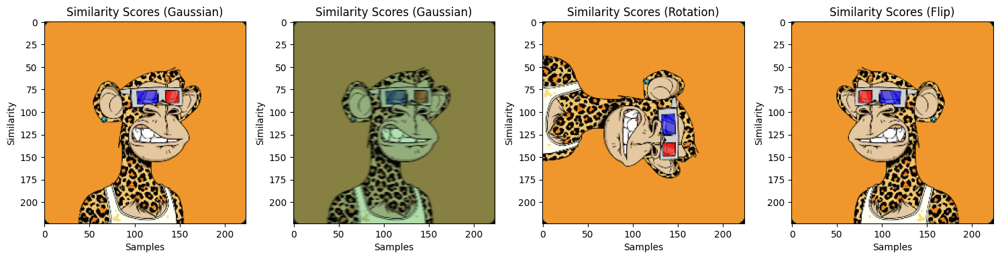

Similarity (Gaussian): ['[[0.9999994]]'], Similarity (Rotation): ['[[1.]]'], Similarity (Flip): ['[[0.9993636]]']


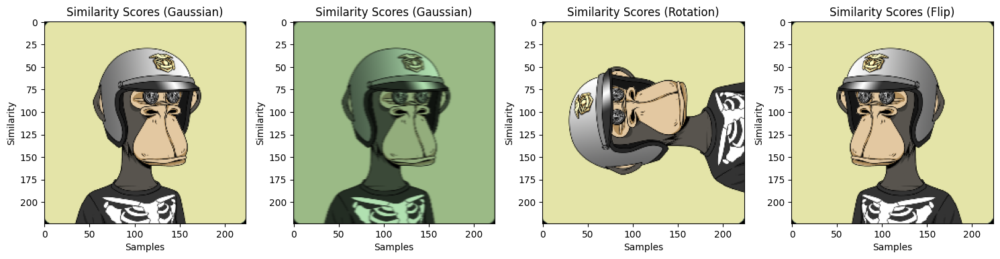

Similarity (Gaussian): ['[[0.9994543]]'], Similarity (Rotation): ['[[0.9999958]]'], Similarity (Flip): ['[[0.99999595]]']


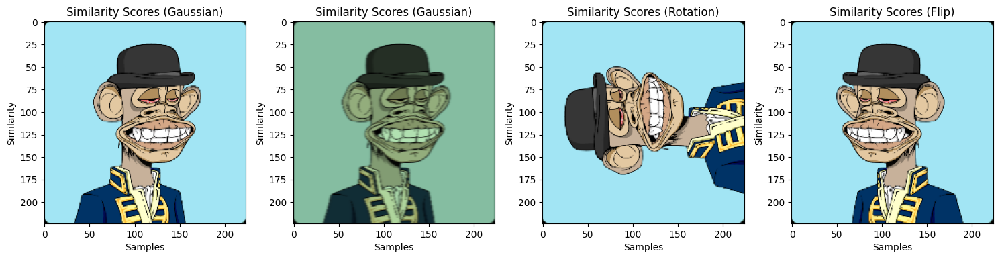

Similarity (Gaussian): ['[[1.]]'], Similarity (Rotation): ['[[0.99999833]]'], Similarity (Flip): ['[[0.9999994]]']


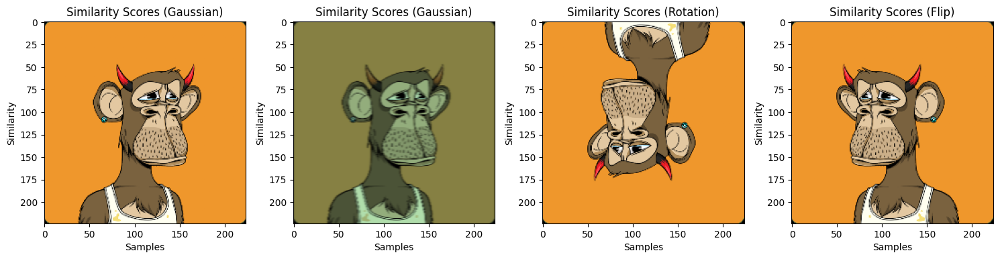

Similarity (Gaussian): ['[[0.99999356]]'], Similarity (Rotation): ['[[0.9999938]]'], Similarity (Flip): ['[[0.8269146]]']


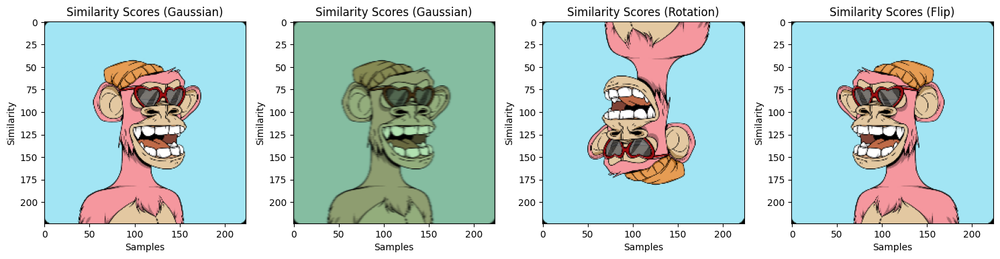

Similarity (Gaussian): ['[[1.]]'], Similarity (Rotation): ['[[0.9999949]]'], Similarity (Flip): ['[[0.99453765]]']


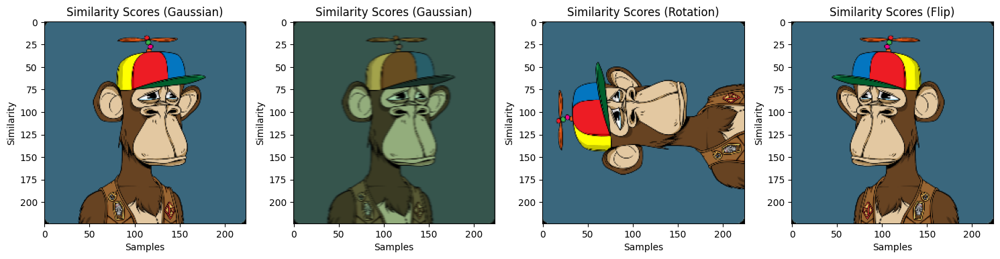

Similarity (Gaussian): ['[[0.9999951]]'], Similarity (Rotation): ['[[0.99998534]]'], Similarity (Flip): ['[[0.9999994]]']


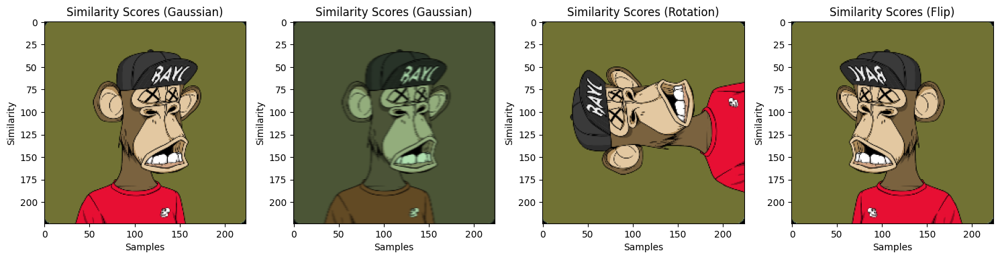

Similarity (Gaussian): ['[[0.99955314]]'], Similarity (Rotation): ['[[0.999997]]'], Similarity (Flip): ['[[0.0178069]]']


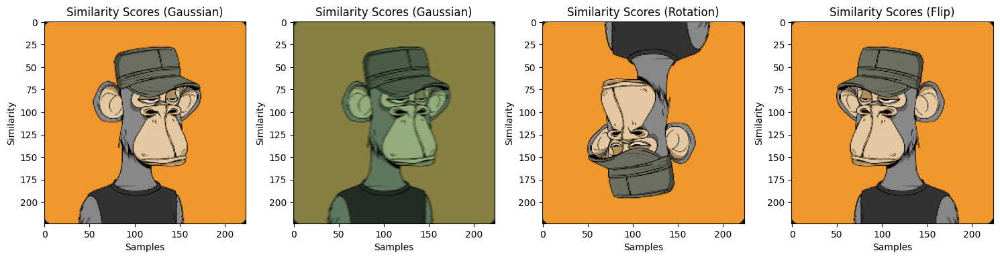

Similarity (Gaussian): ['[[0.9999999]]'], Similarity (Rotation): ['[[0.99998355]]'], Similarity (Flip): ['[[0.99999475]]']


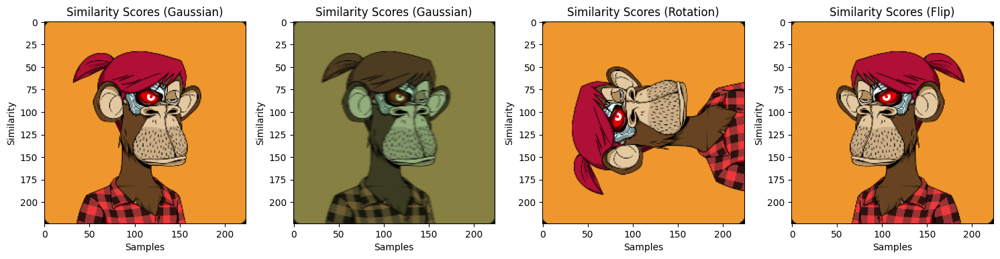

Similarity (Gaussian): ['[[0.9999938]]'], Similarity (Rotation): ['[[0.99999547]]'], Similarity (Flip): ['[[0.99989045]]']


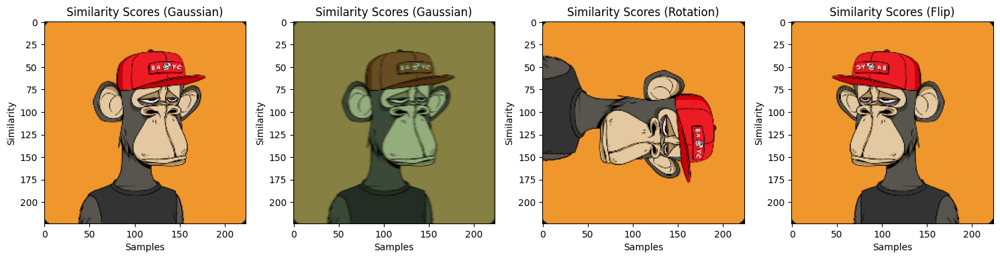

Similarity (Gaussian): ['[[0.99999976]]'], Similarity (Rotation): ['[[0.99999845]]'], Similarity (Flip): ['[[0.9999713]]']


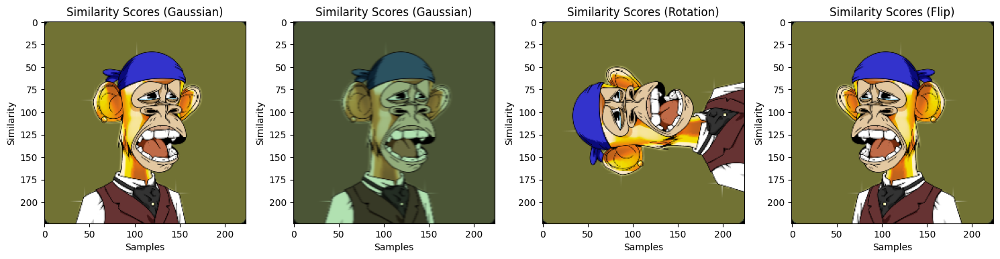

Similarity (Gaussian): ['[[0.99992895]]'], Similarity (Rotation): ['[[0.99999845]]'], Similarity (Flip): ['[[0.98992443]]']


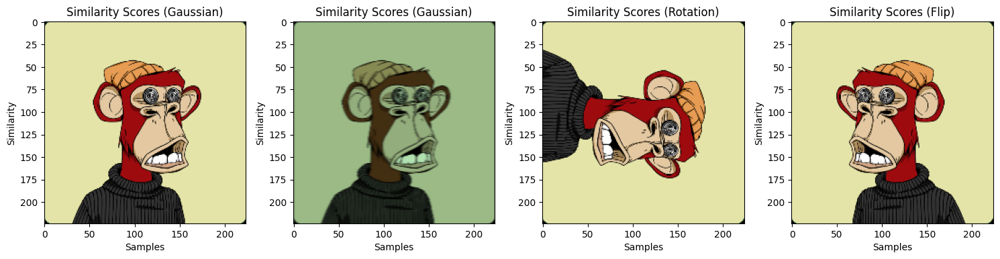

Similarity (Gaussian): ['[[1.]]'], Similarity (Rotation): ['[[0.9999993]]'], Similarity (Flip): ['[[0.0629347]]']


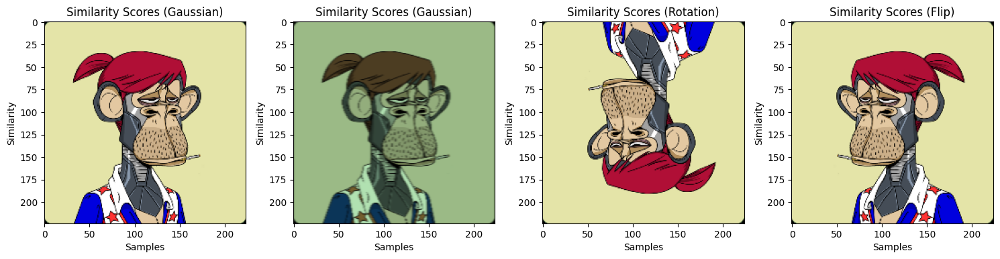

Similarity (Gaussian): ['[[0.9999988]]'], Similarity (Rotation): ['[[0.9999974]]'], Similarity (Flip): ['[[0.99873465]]']


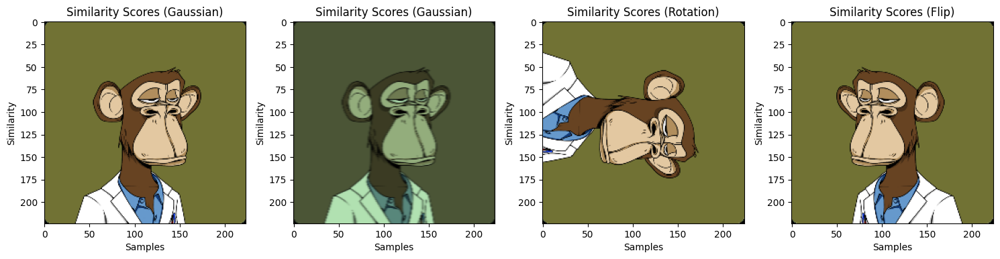

Similarity (Gaussian): ['[[0.99999976]]'], Similarity (Rotation): ['[[1.]]'], Similarity (Flip): ['[[0.99408144]]']


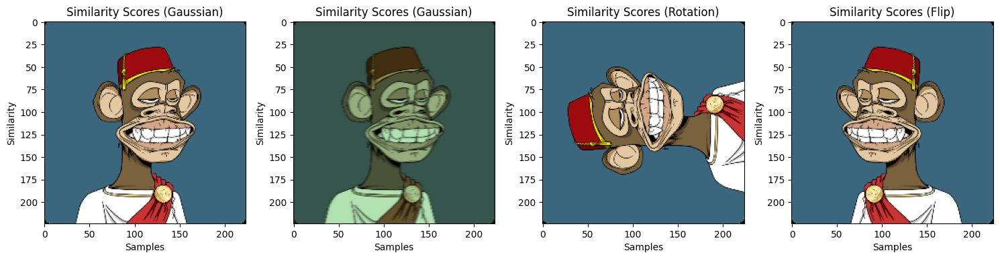

Similarity (Gaussian): ['[[0.99990904]]'], Similarity (Rotation): ['[[0.9999999]]'], Similarity (Flip): ['[[0.9977239]]']


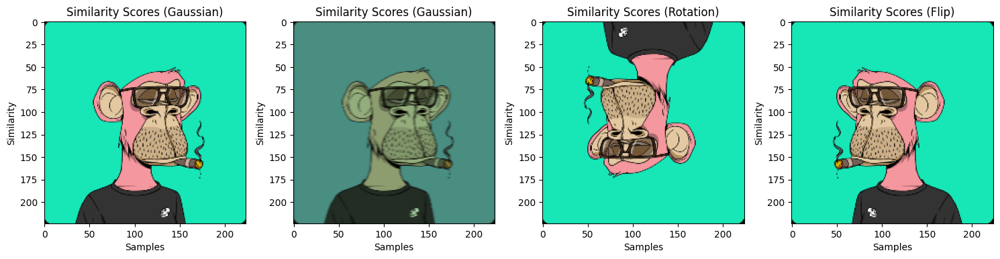

Similarity (Gaussian): ['[[1.]]'], Similarity (Rotation): ['[[0.99999976]]'], Similarity (Flip): ['[[0.9998913]]']


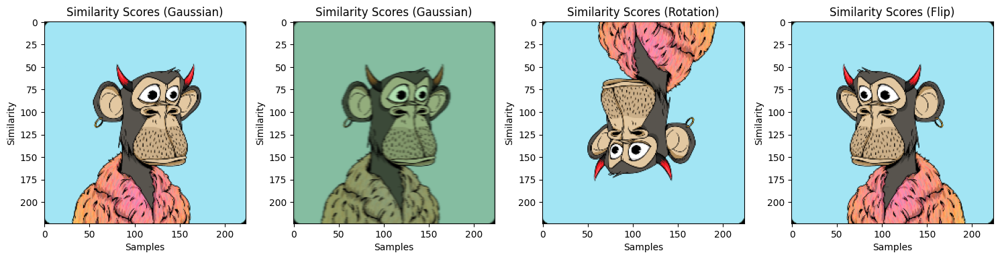

Similarity (Gaussian): ['[[0.9999999]]'], Similarity (Rotation): ['[[0.9999994]]'], Similarity (Flip): ['[[0.93672025]]']


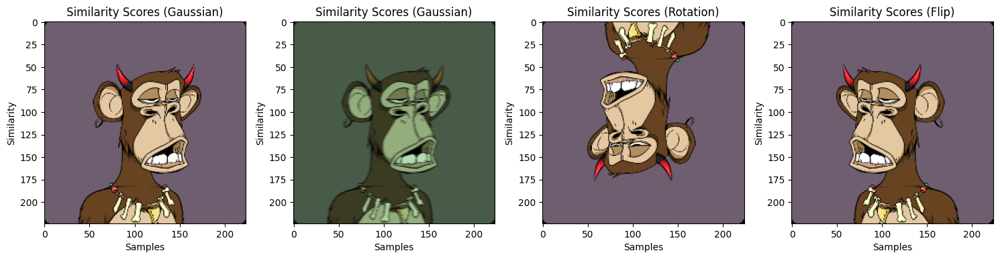

Similarity (Gaussian): ['[[0.99999976]]'], Similarity (Rotation): ['[[1.]]'], Similarity (Flip): ['[[0.9999937]]']


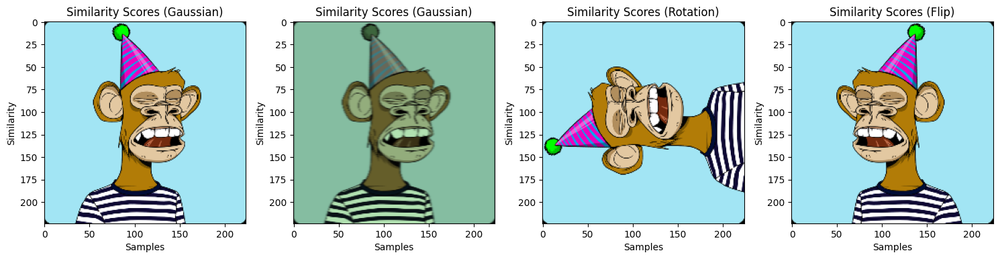

Similarity (Gaussian): ['[[1.]]'], Similarity (Rotation): ['[[0.9999999]]'], Similarity (Flip): ['[[1.]]']


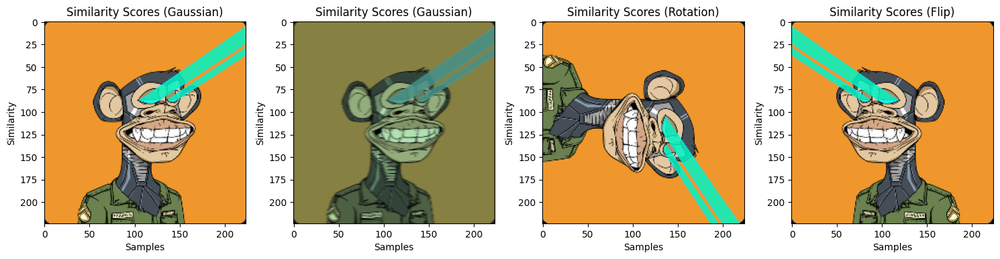

Similarity (Gaussian): ['[[0.9999132]]'], Similarity (Rotation): ['[[0.9999753]]'], Similarity (Flip): ['[[3.067894e-06]]']


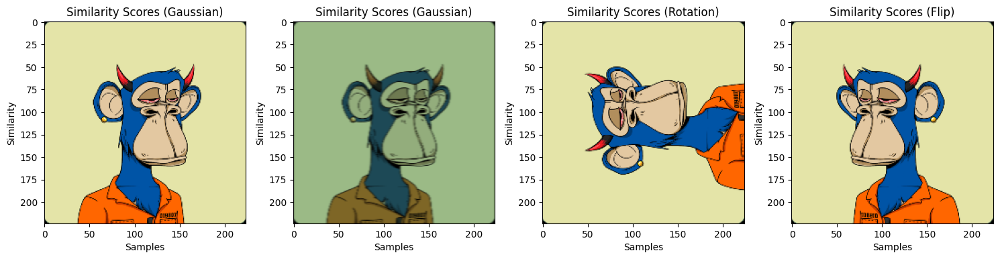

Similarity (Gaussian): ['[[1.]]'], Similarity (Rotation): ['[[0.9999975]]'], Similarity (Flip): ['[[0.9999999]]']


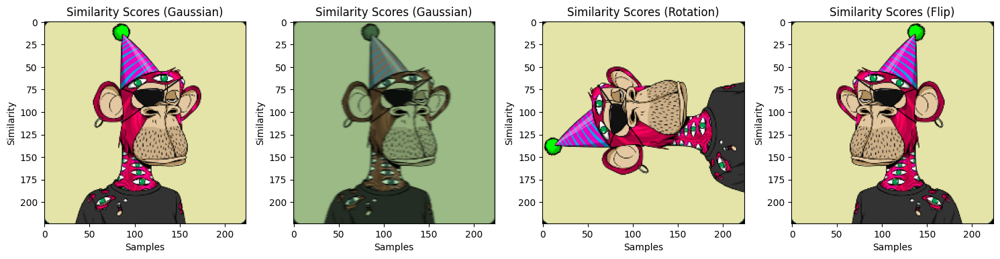

Similarity (Gaussian): ['[[1.]]'], Similarity (Rotation): ['[[1.]]'], Similarity (Flip): ['[[0.99999034]]']


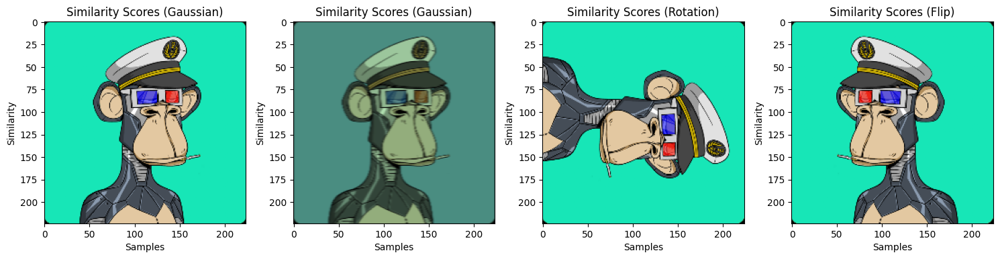

Similarity (Gaussian): ['[[1.]]'], Similarity (Rotation): ['[[1.]]'], Similarity (Flip): ['[[0.9999894]]']


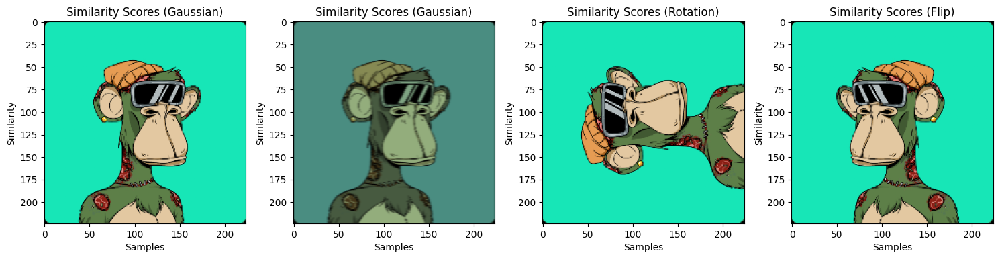

Similarity (Gaussian): ['[[0.9999999]]'], Similarity (Rotation): ['[[0.9999932]]'], Similarity (Flip): ['[[0.9999399]]']


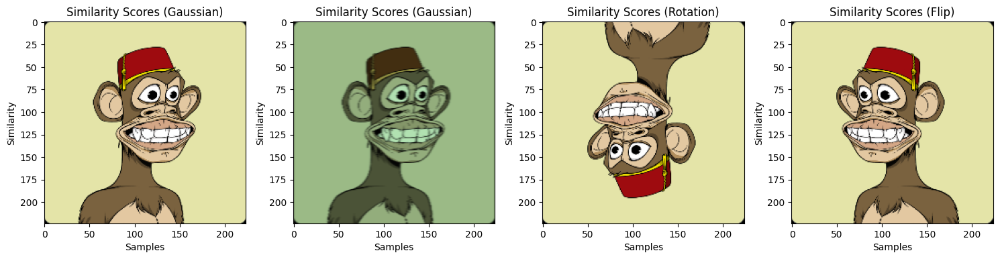

Similarity (Gaussian): ['[[0.9999999]]'], Similarity (Rotation): ['[[0.9999975]]'], Similarity (Flip): ['[[0.45875582]]']


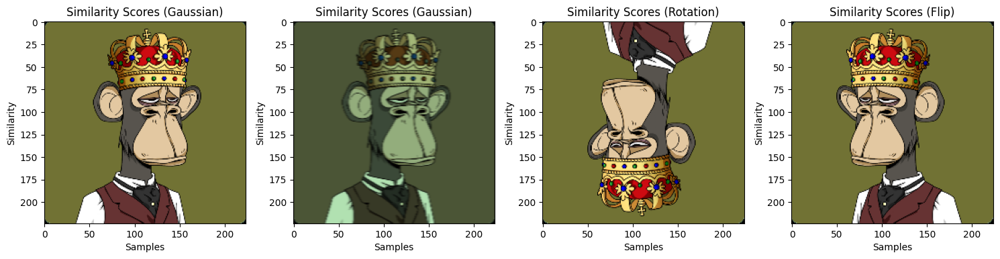

Similarity (Gaussian): ['[[0.99998677]]'], Similarity (Rotation): ['[[0.9999999]]'], Similarity (Flip): ['[[0.99999917]]']


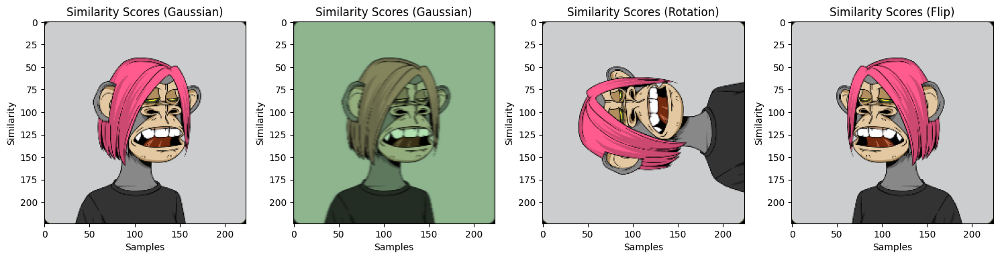

Similarity (Gaussian): ['[[0.9999968]]'], Similarity (Rotation): ['[[0.99999857]]'], Similarity (Flip): ['[[0.89561206]]']


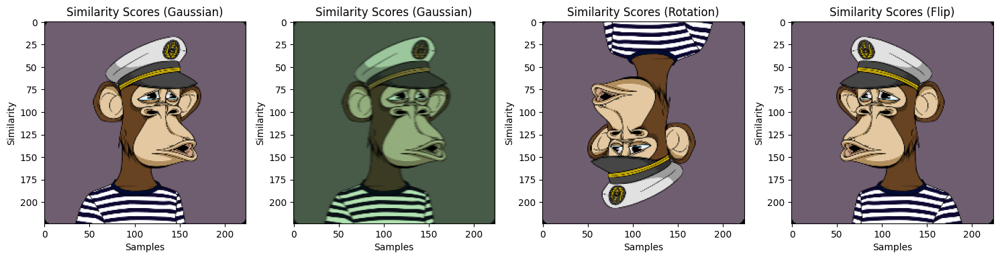

Similarity (Gaussian): ['[[0.9999999]]'], Similarity (Rotation): ['[[0.9999999]]'], Similarity (Flip): ['[[0.99997866]]']


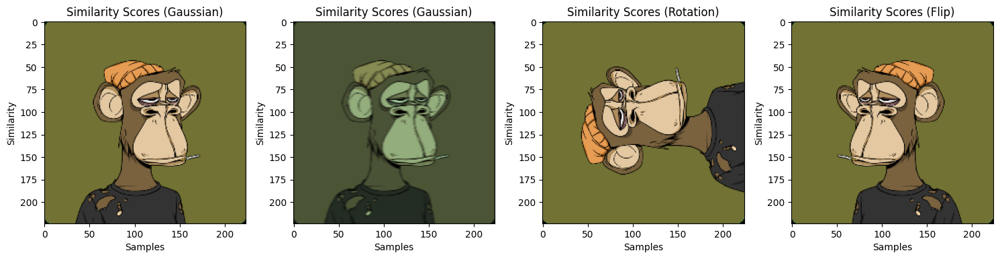

Similarity (Gaussian): ['[[0.99999976]]'], Similarity (Rotation): ['[[0.99999464]]'], Similarity (Flip): ['[[0.9999974]]']


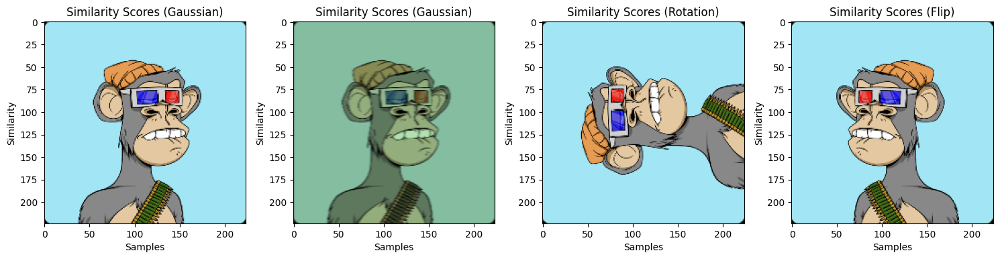

Similarity (Gaussian): ['[[1.]]'], Similarity (Rotation): ['[[0.9999987]]'], Similarity (Flip): ['[[0.99977297]]']


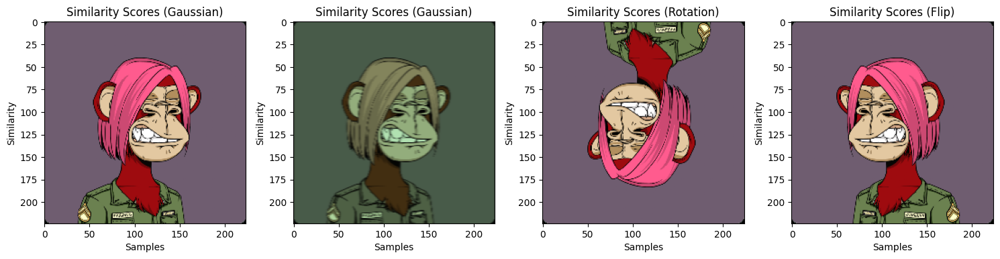

Similarity (Gaussian): ['[[0.9998994]]'], Similarity (Rotation): ['[[0.9999969]]'], Similarity (Flip): ['[[0.33735904]]']


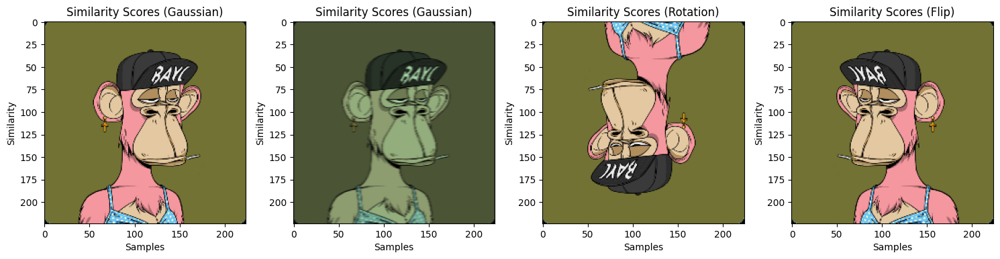

Similarity (Gaussian): ['[[0.9995296]]'], Similarity (Rotation): ['[[0.99998856]]'], Similarity (Flip): ['[[0.99953914]]']


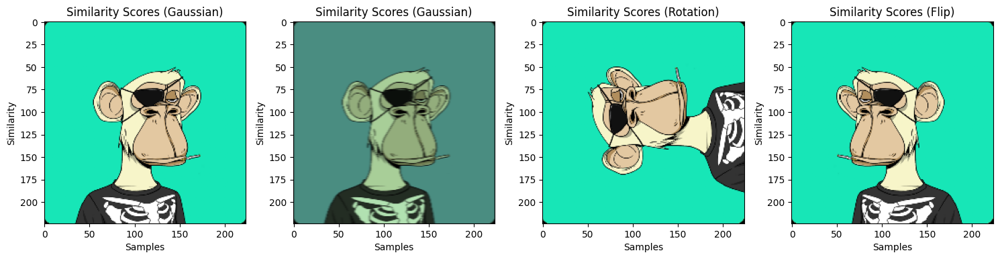

Similarity (Gaussian): ['[[1.]]'], Similarity (Rotation): ['[[1.]]'], Similarity (Flip): ['[[0.9999883]]']


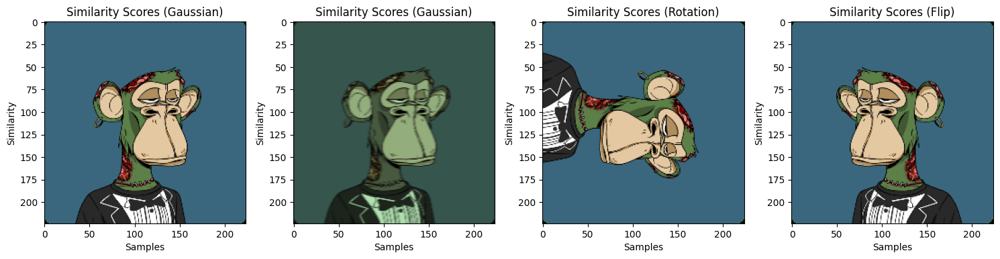

Similarity (Gaussian): ['[[0.99998784]]'], Similarity (Rotation): ['[[0.99999964]]'], Similarity (Flip): ['[[0.9999908]]']


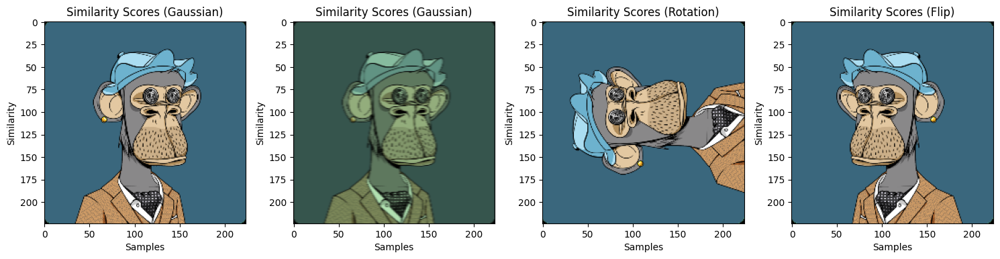

Similarity (Gaussian): ['[[0.99999976]]'], Similarity (Rotation): ['[[0.9999999]]'], Similarity (Flip): ['[[0.9994809]]']


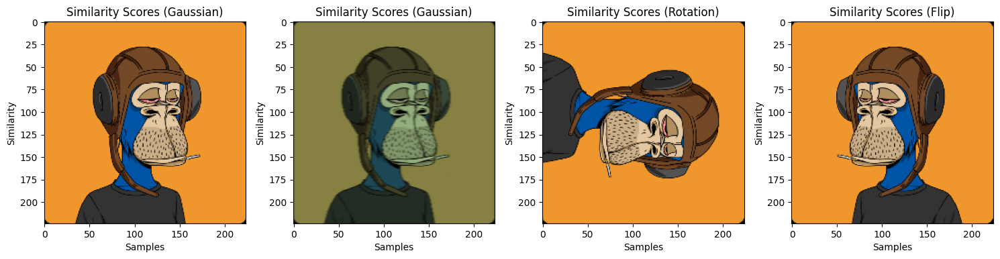

Similarity (Gaussian): ['[[0.9999999]]'], Similarity (Rotation): ['[[0.9999951]]'], Similarity (Flip): ['[[0.9999999]]']


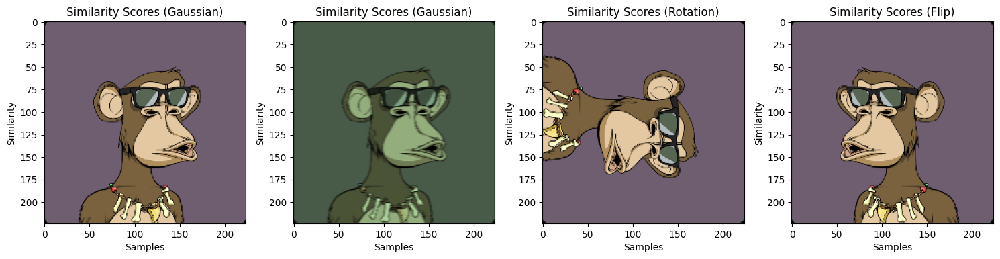

Similarity (Gaussian): ['[[0.9999999]]'], Similarity (Rotation): ['[[1.]]'], Similarity (Flip): ['[[9.183069e-05]]']


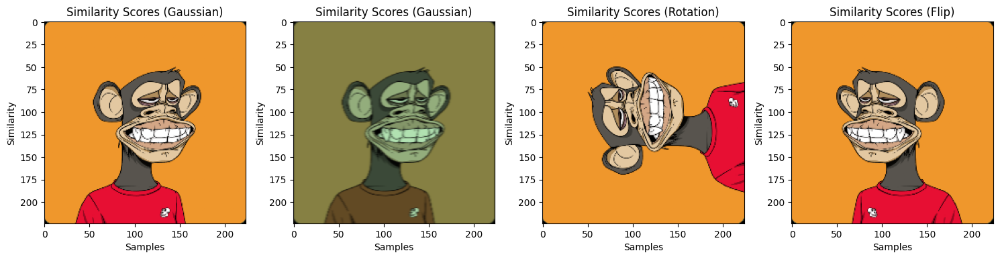

Similarity (Gaussian): ['[[0.9999906]]'], Similarity (Rotation): ['[[0.99999976]]'], Similarity (Flip): ['[[0.9999995]]']


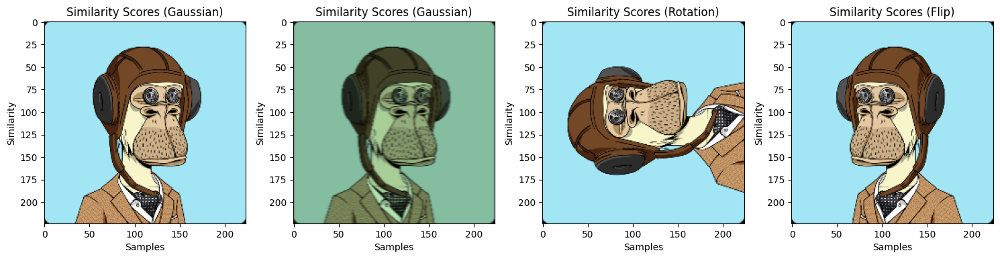

Similarity (Gaussian): ['[[0.99999917]]'], Similarity (Rotation): ['[[0.9999964]]'], Similarity (Flip): ['[[0.99795]]']


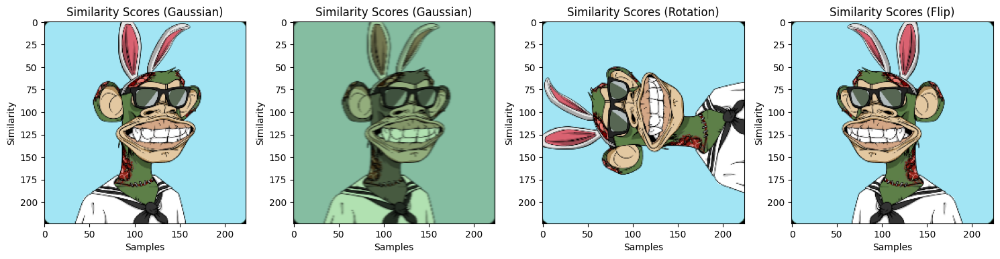

Similarity (Gaussian): ['[[1.]]'], Similarity (Rotation): ['[[0.9999999]]'], Similarity (Flip): ['[[0.9999999]]']


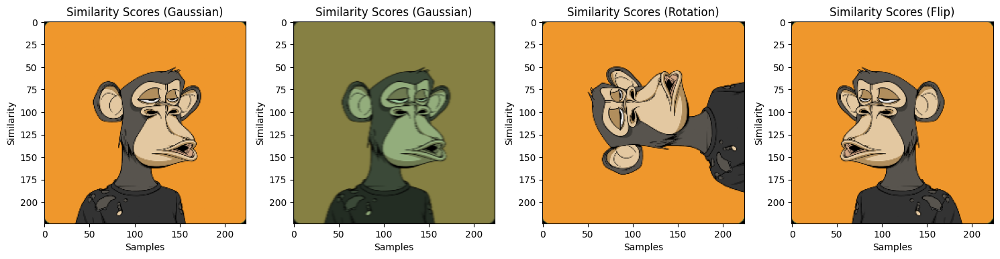

Similarity (Gaussian): ['[[0.9999987]]'], Similarity (Rotation): ['[[1.]]'], Similarity (Flip): ['[[0.9999993]]']


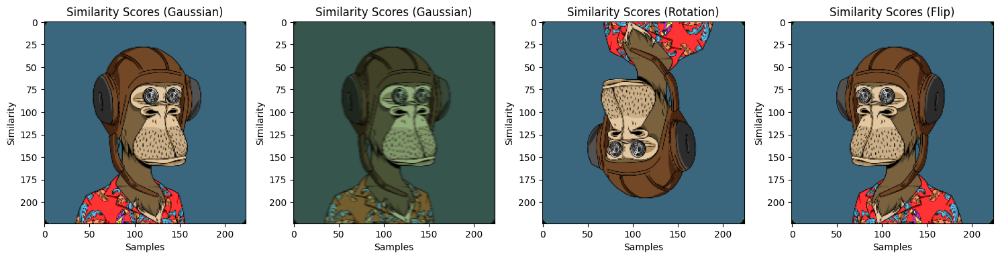

Similarity (Gaussian): ['[[0.9999808]]'], Similarity (Rotation): ['[[0.99999976]]'], Similarity (Flip): ['[[0.9999944]]']


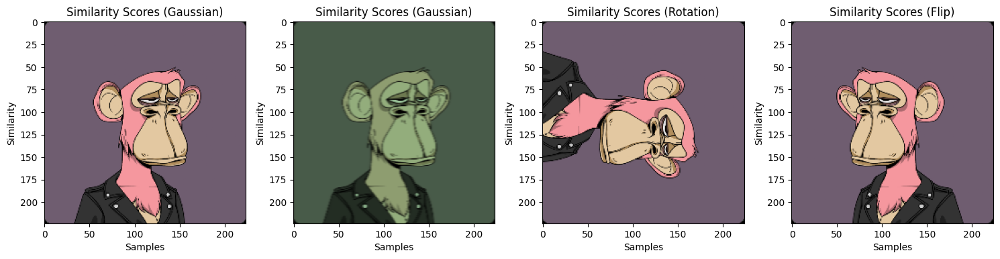

Similarity (Gaussian): ['[[0.9999987]]'], Similarity (Rotation): ['[[0.9999999]]'], Similarity (Flip): ['[[0.9999982]]']


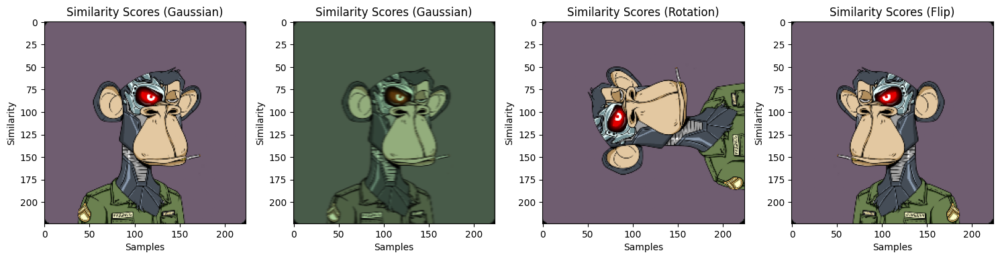

Similarity (Gaussian): ['[[0.9999149]]'], Similarity (Rotation): ['[[1.]]'], Similarity (Flip): ['[[0.99994373]]']


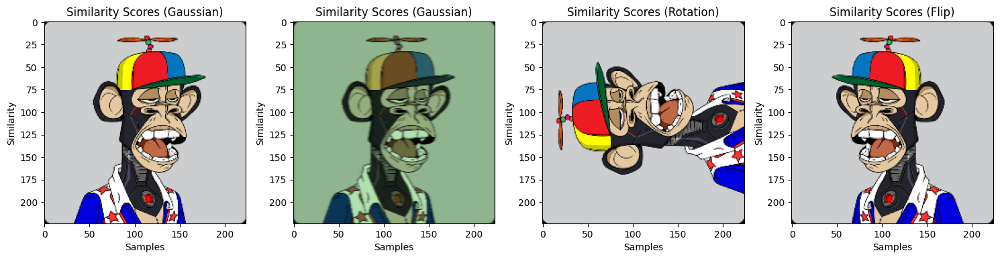

Similarity (Gaussian): ['[[1.]]'], Similarity (Rotation): ['[[0.9999844]]'], Similarity (Flip): ['[[1.]]']


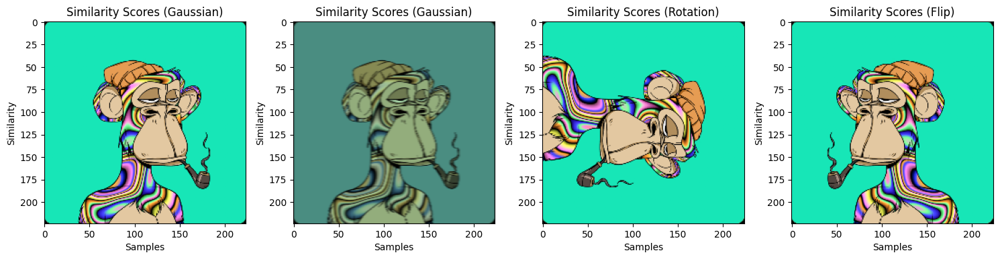

Similarity (Gaussian): ['[[0.9999999]]'], Similarity (Rotation): ['[[1.]]'], Similarity (Flip): ['[[0.9753185]]']


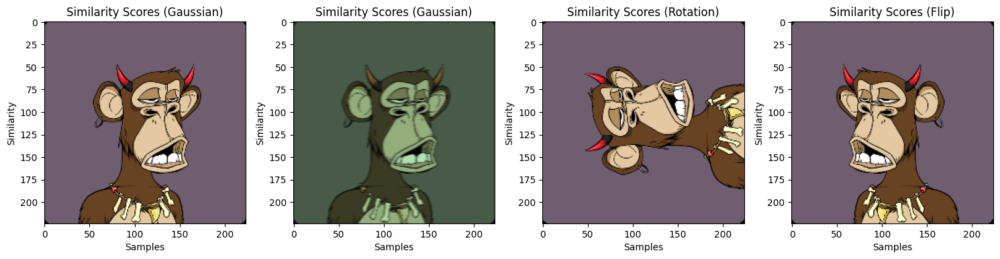

Similarity (Gaussian): ['[[0.99999976]]'], Similarity (Rotation): ['[[1.]]'], Similarity (Flip): ['[[0.99999666]]']


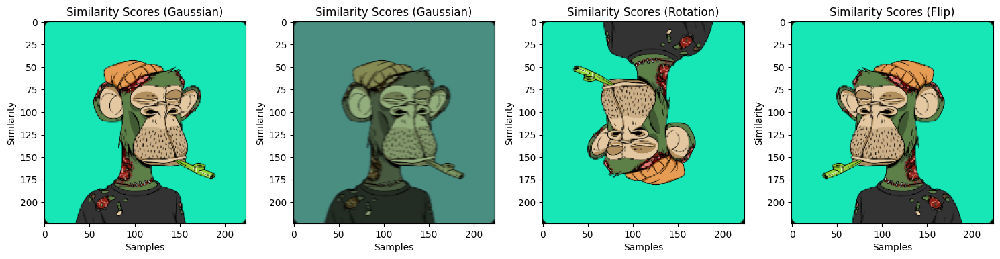

Similarity (Gaussian): ['[[1.]]'], Similarity (Rotation): ['[[0.99999976]]'], Similarity (Flip): ['[[1.]]']


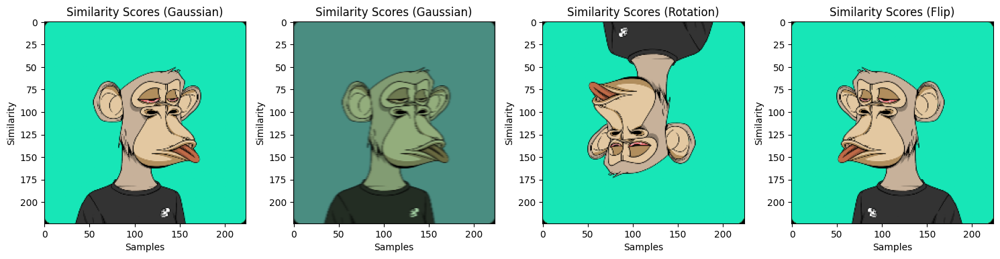

Similarity (Gaussian): ['[[0.9999875]]'], Similarity (Rotation): ['[[0.99999833]]'], Similarity (Flip): ['[[0.9999995]]']


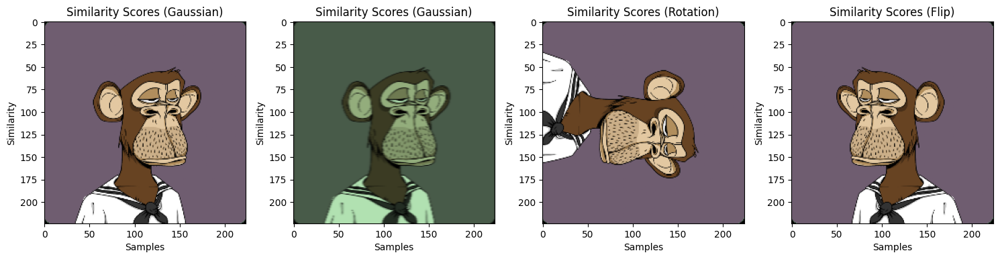

Similarity (Gaussian): ['[[0.9999999]]'], Similarity (Rotation): ['[[0.9999995]]'], Similarity (Flip): ['[[0.3715221]]']


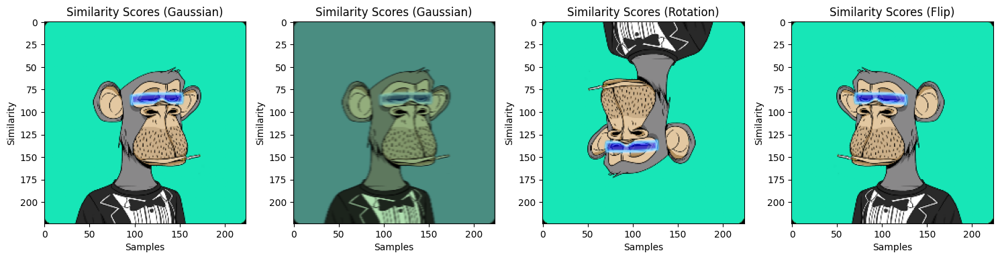

Similarity (Gaussian): ['[[0.99997747]]'], Similarity (Rotation): ['[[1.]]'], Similarity (Flip): ['[[0.9999993]]']


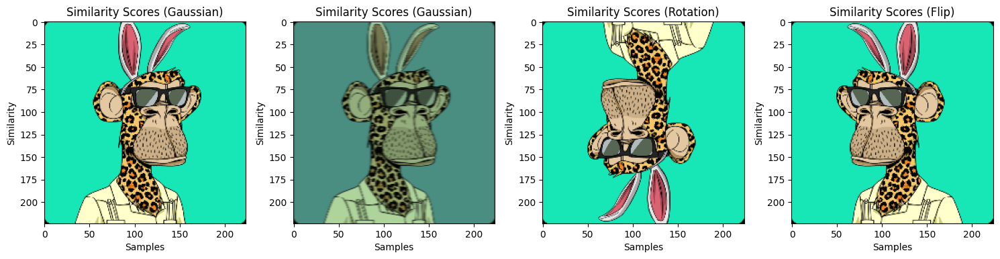

Similarity (Gaussian): ['[[1.]]'], Similarity (Rotation): ['[[1.]]'], Similarity (Flip): ['[[0.9999999]]']


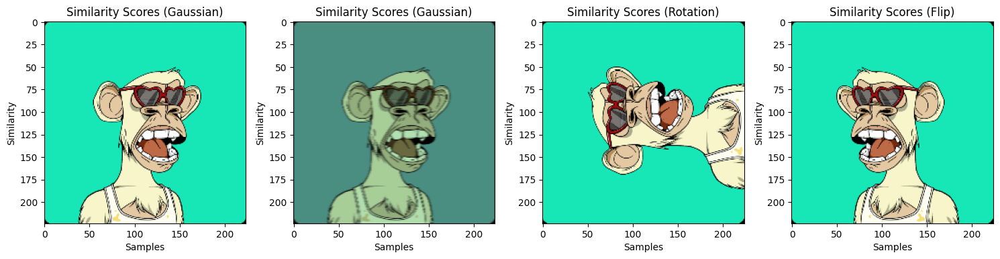

Similarity (Gaussian): ['[[0.9999993]]'], Similarity (Rotation): ['[[0.9999049]]'], Similarity (Flip): ['[[0.99999905]]']


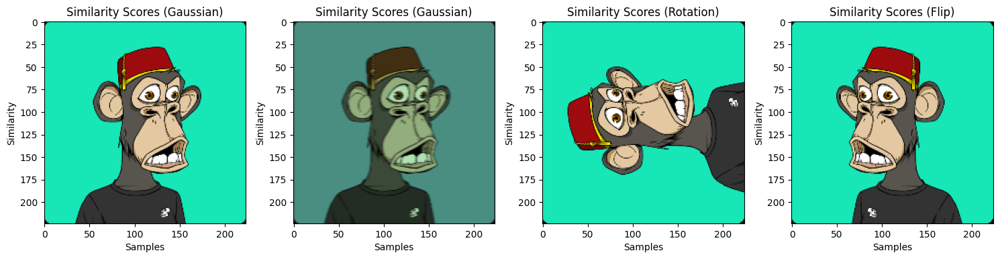

Similarity (Gaussian): ['[[0.9999999]]'], Similarity (Rotation): ['[[0.999992]]'], Similarity (Flip): ['[[0.9995017]]']


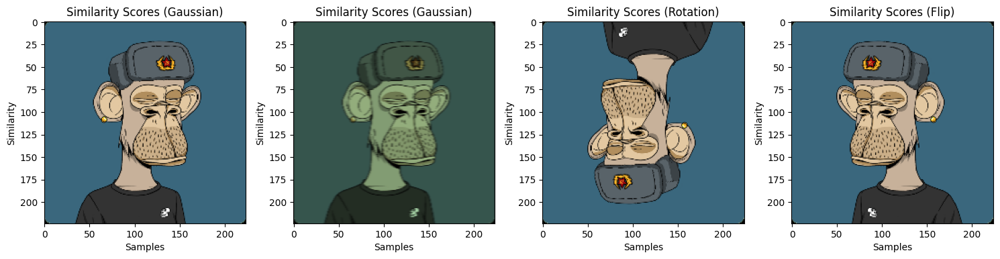

Similarity (Gaussian): ['[[0.99999976]]'], Similarity (Rotation): ['[[0.99999845]]'], Similarity (Flip): ['[[0.9999982]]']


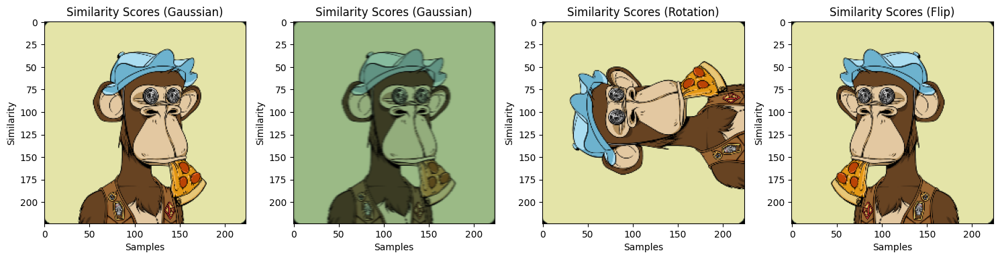

Similarity (Gaussian): ['[[1.]]'], Similarity (Rotation): ['[[0.99999833]]'], Similarity (Flip): ['[[0.9975024]]']


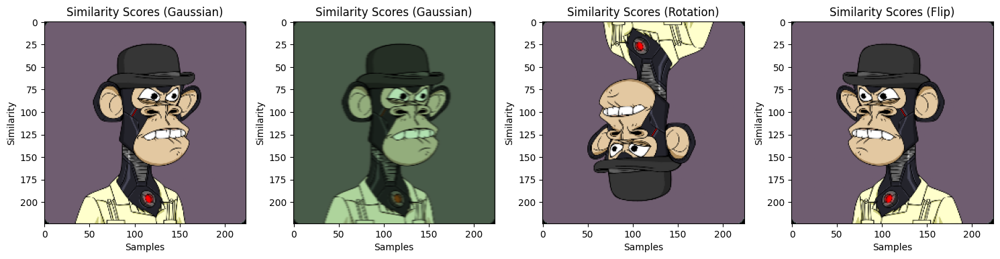

Similarity (Gaussian): ['[[0.99999976]]'], Similarity (Rotation): ['[[0.99999356]]'], Similarity (Flip): ['[[0.996182]]']


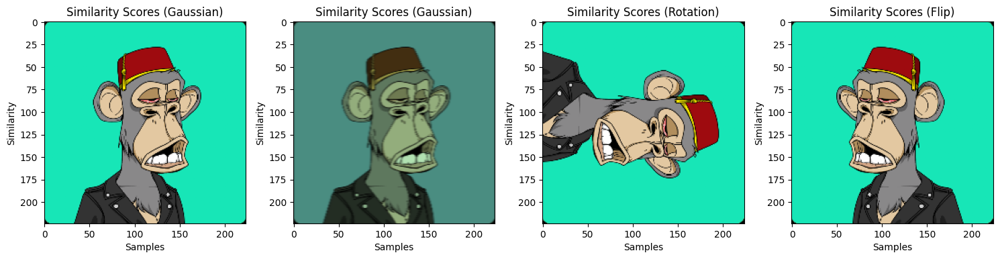

Similarity (Gaussian): ['[[0.99999976]]'], Similarity (Rotation): ['[[1.]]'], Similarity (Flip): ['[[0.9992736]]']


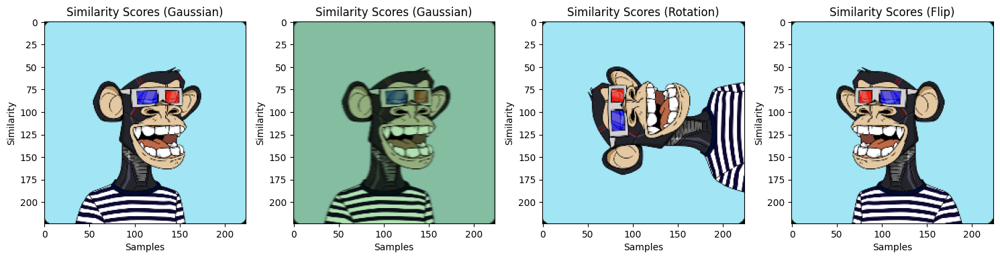

Similarity (Gaussian): ['[[1.]]'], Similarity (Rotation): ['[[1.]]'], Similarity (Flip): ['[[0.9999999]]']


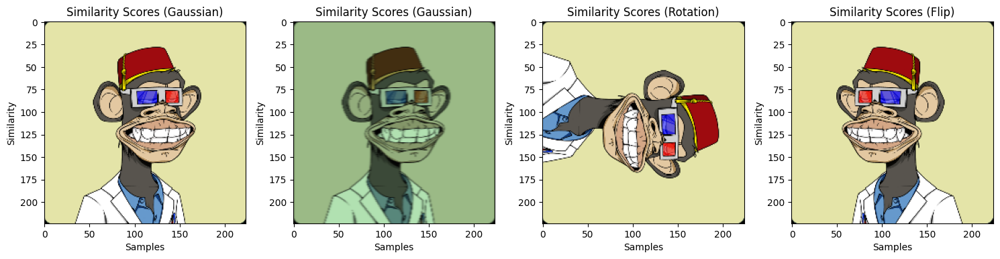

Similarity (Gaussian): ['[[1.]]'], Similarity (Rotation): ['[[1.]]'], Similarity (Flip): ['[[1.]]']


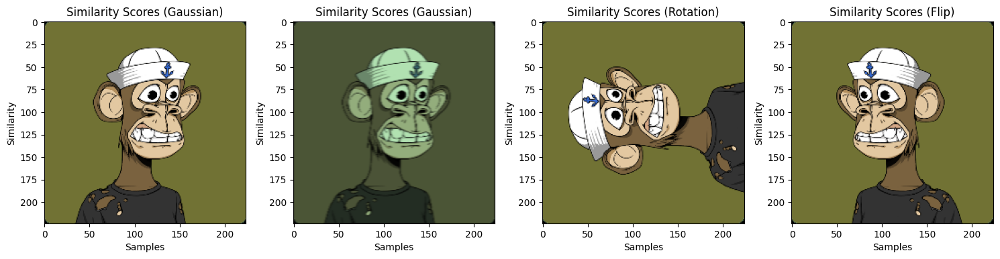

Similarity (Gaussian): ['[[0.99999976]]'], Similarity (Rotation): ['[[0.99999356]]'], Similarity (Flip): ['[[0.93388313]]']


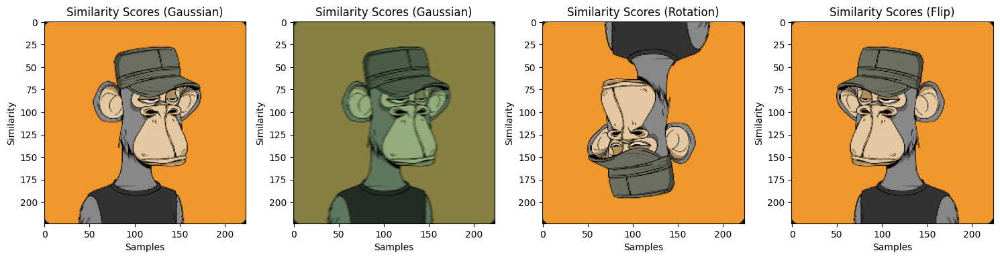

Similarity (Gaussian): ['[[0.9999999]]'], Similarity (Rotation): ['[[0.99998355]]'], Similarity (Flip): ['[[0.99995875]]']


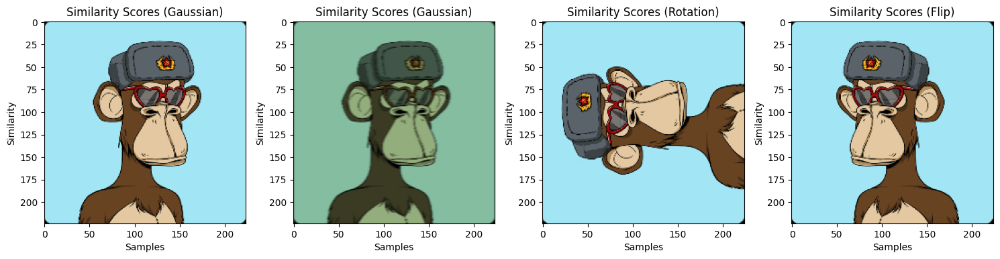

Similarity (Gaussian): ['[[1.]]'], Similarity (Rotation): ['[[0.9999995]]'], Similarity (Flip): ['[[0.99998355]]']


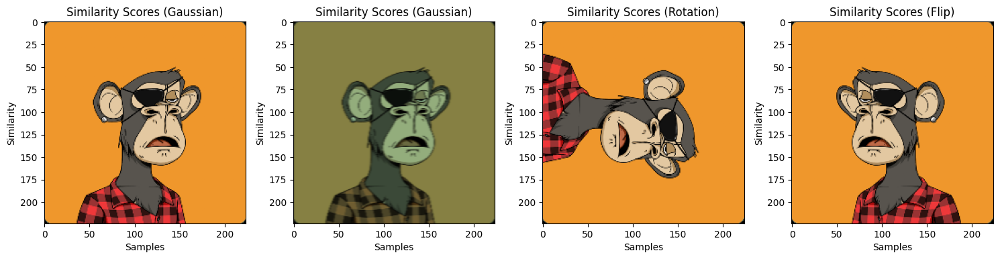

Similarity (Gaussian): ['[[0.9999999]]'], Similarity (Rotation): ['[[0.9999999]]'], Similarity (Flip): ['[[1.]]']


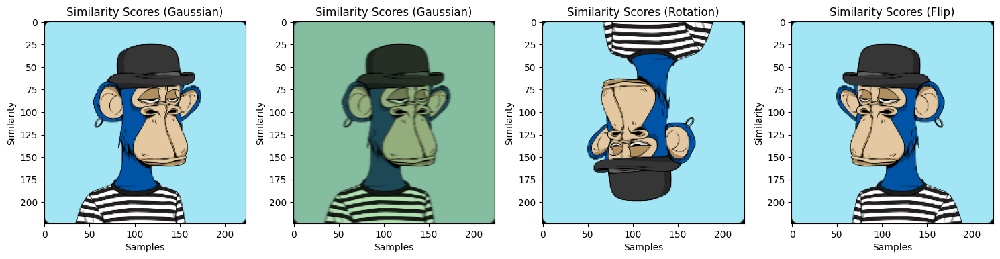

Similarity (Gaussian): ['[[1.]]'], Similarity (Rotation): ['[[0.9999995]]'], Similarity (Flip): ['[[0.9999987]]']


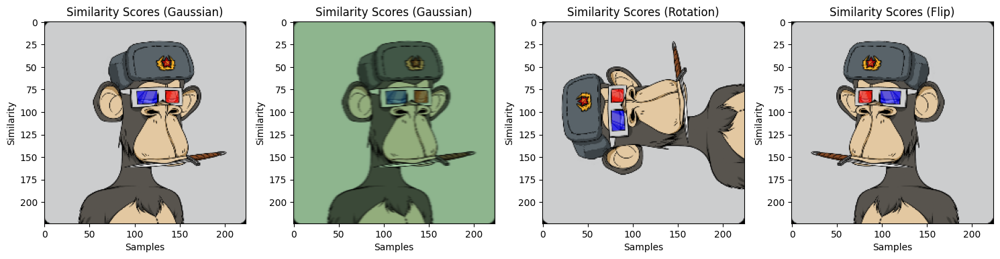

Similarity (Gaussian): ['[[1.]]'], Similarity (Rotation): ['[[1.]]'], Similarity (Flip): ['[[0.9999995]]']


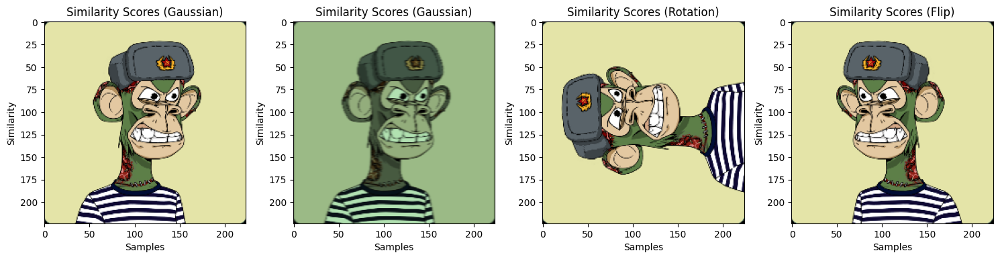

Similarity (Gaussian): ['[[1.]]'], Similarity (Rotation): ['[[0.99999976]]'], Similarity (Flip): ['[[0.99987376]]']


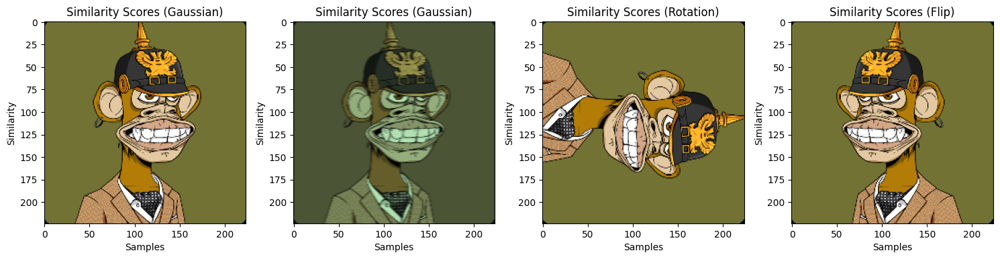

Similarity (Gaussian): ['[[0.9999757]]'], Similarity (Rotation): ['[[0.99999917]]'], Similarity (Flip): ['[[0.99999523]]']


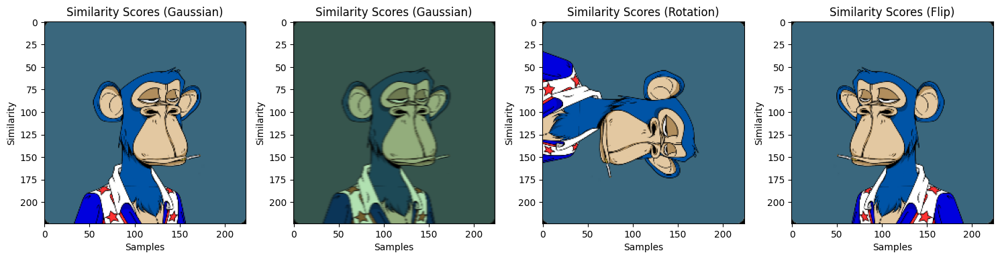

Similarity (Gaussian): ['[[0.99999917]]'], Similarity (Rotation): ['[[1.]]'], Similarity (Flip): ['[[0.99996674]]']


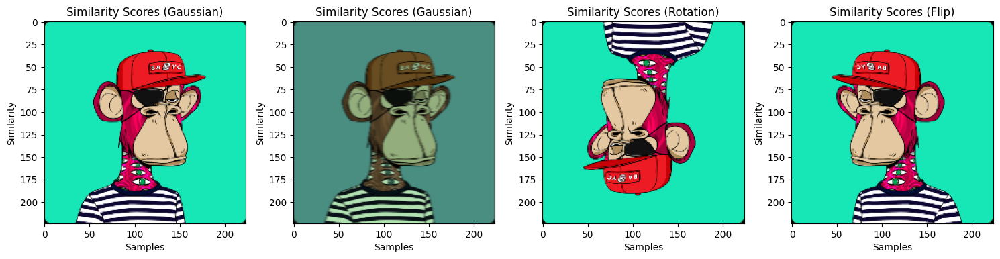

Similarity (Gaussian): ['[[0.9999999]]'], Similarity (Rotation): ['[[1.]]'], Similarity (Flip): ['[[0.99999976]]']


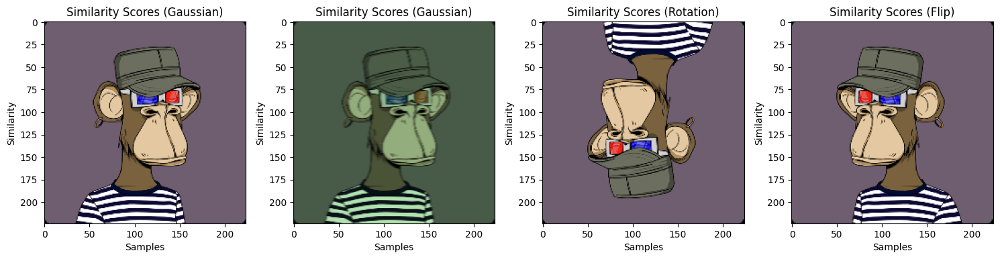

Similarity (Gaussian): ['[[0.9999994]]'], Similarity (Rotation): ['[[0.9999994]]'], Similarity (Flip): ['[[0.9999782]]']


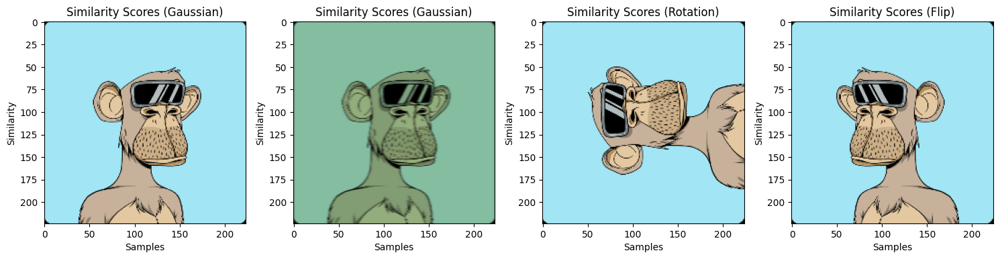

Similarity (Gaussian): ['[[1.]]'], Similarity (Rotation): ['[[0.9999999]]'], Similarity (Flip): ['[[0.9999641]]']


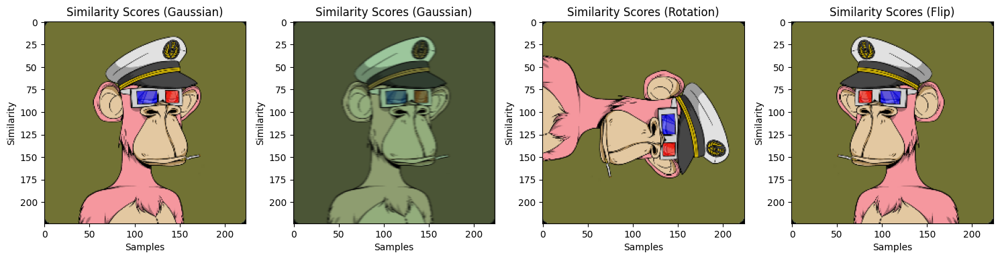

Similarity (Gaussian): ['[[0.9999993]]'], Similarity (Rotation): ['[[0.9999999]]'], Similarity (Flip): ['[[0.9999956]]']


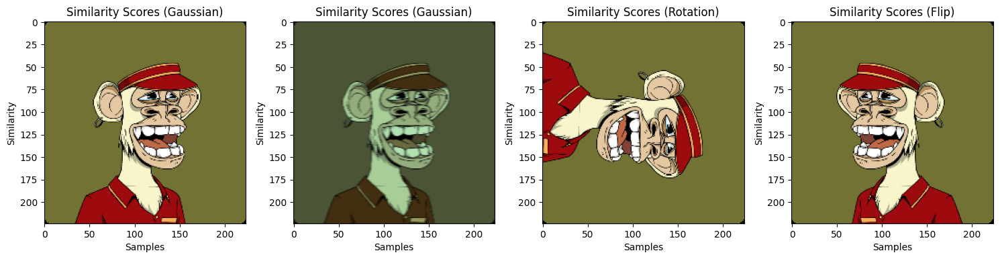

Similarity (Gaussian): ['[[0.9999981]]'], Similarity (Rotation): ['[[0.9998702]]'], Similarity (Flip): ['[[0.99999475]]']


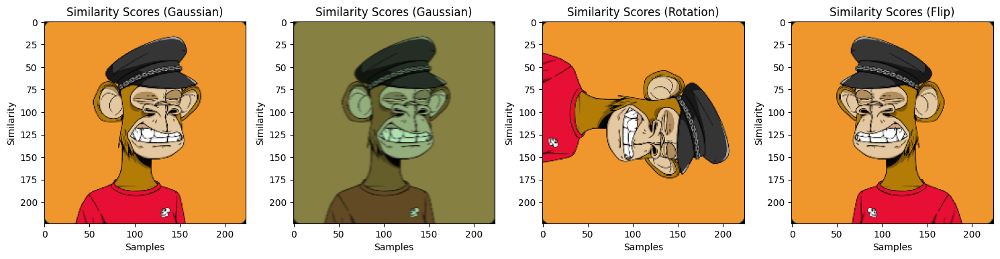

Similarity (Gaussian): ['[[1.]]'], Similarity (Rotation): ['[[0.9999894]]'], Similarity (Flip): ['[[1.]]']


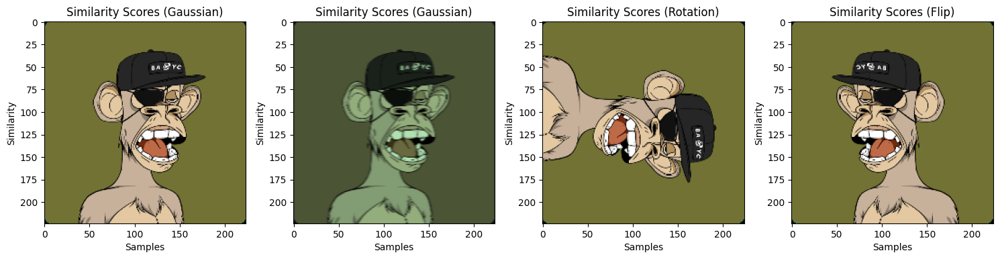

Similarity (Gaussian): ['[[0.99964964]]'], Similarity (Rotation): ['[[0.99982697]]'], Similarity (Flip): ['[[0.9997583]]']


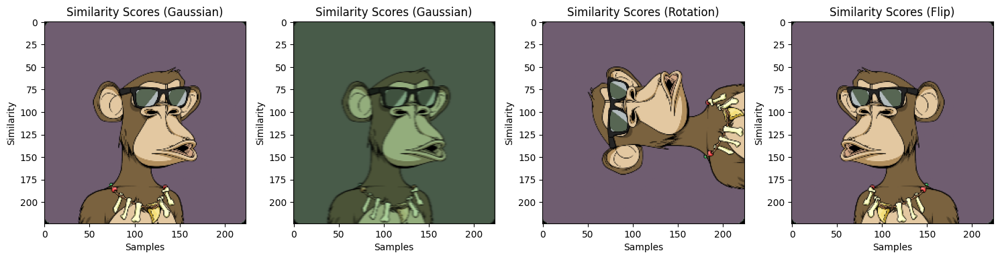

Similarity (Gaussian): ['[[0.9999999]]'], Similarity (Rotation): ['[[1.]]'], Similarity (Flip): ['[[0.99993145]]']


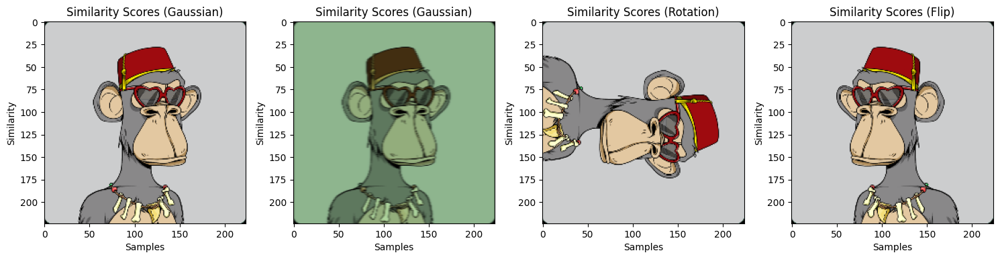

Similarity (Gaussian): ['[[1.]]'], Similarity (Rotation): ['[[1.]]'], Similarity (Flip): ['[[0.9998079]]']


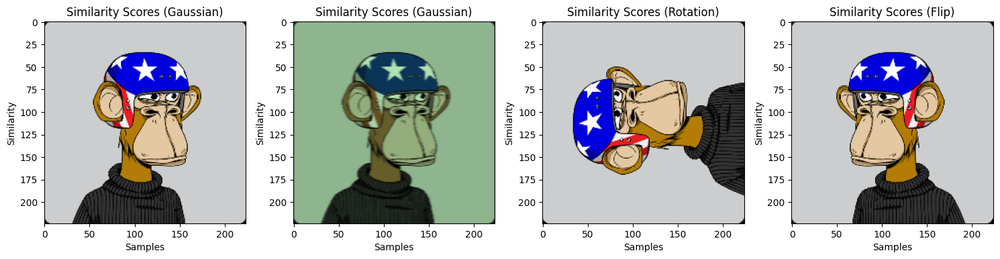

Similarity (Gaussian): ['[[1.]]'], Similarity (Rotation): ['[[0.99999917]]'], Similarity (Flip): ['[[0.99999964]]']


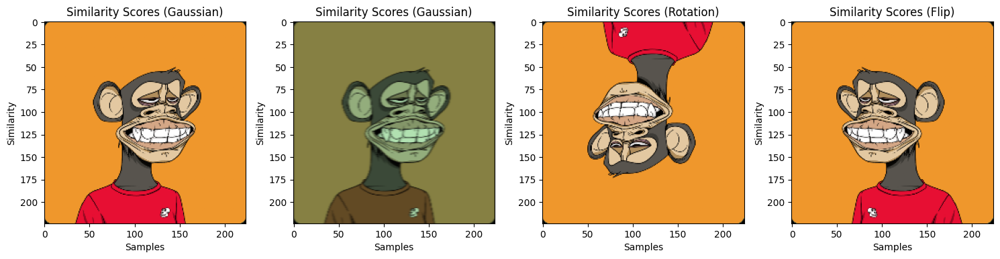

Similarity (Gaussian): ['[[0.9999906]]'], Similarity (Rotation): ['[[0.99999976]]'], Similarity (Flip): ['[[0.9999995]]']


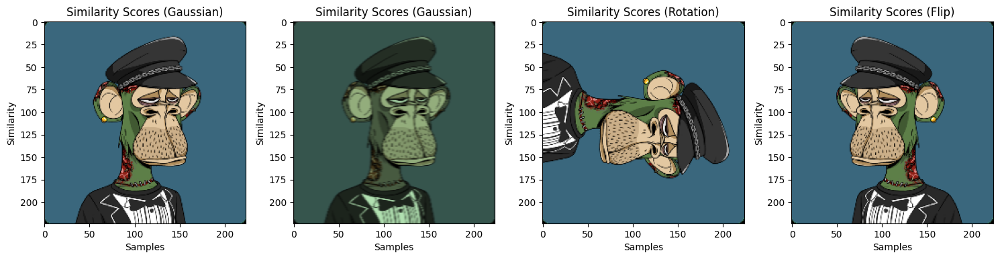

Similarity (Gaussian): ['[[0.99999833]]'], Similarity (Rotation): ['[[0.99999607]]'], Similarity (Flip): ['[[0.999998]]']


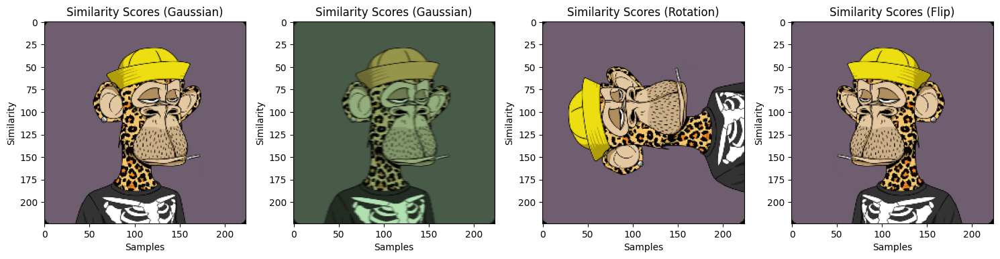

Similarity (Gaussian): ['[[0.9995894]]'], Similarity (Rotation): ['[[1.]]'], Similarity (Flip): ['[[0.988992]]']


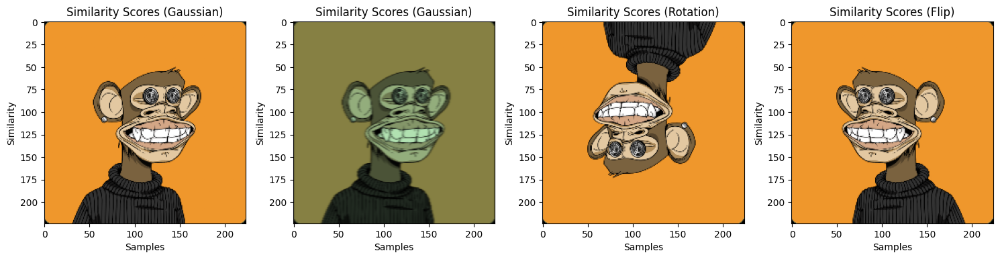

Similarity (Gaussian): ['[[0.99999607]]'], Similarity (Rotation): ['[[0.9993119]]'], Similarity (Flip): ['[[0.7534269]]']


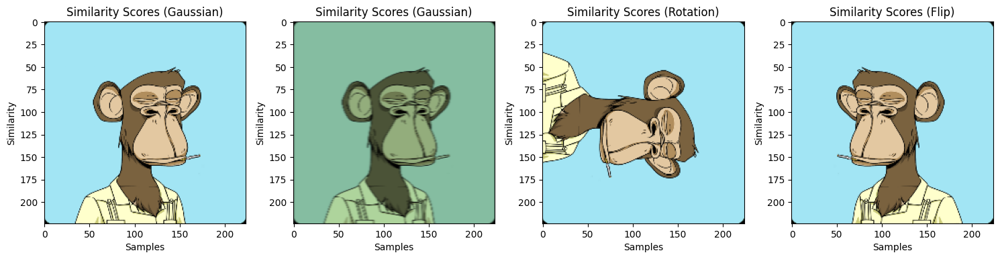

Similarity (Gaussian): ['[[1.]]'], Similarity (Rotation): ['[[0.9999993]]'], Similarity (Flip): ['[[0.9999566]]']


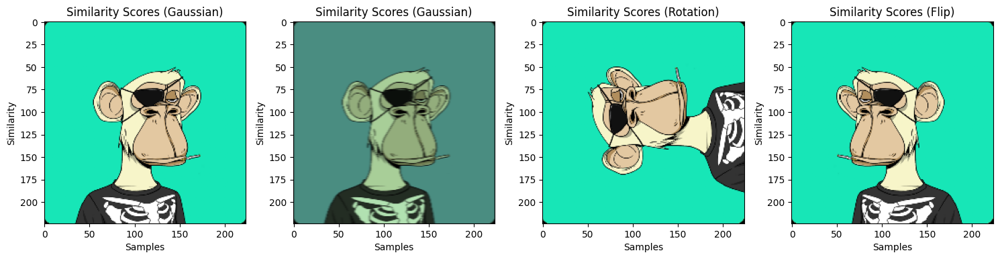

Similarity (Gaussian): ['[[1.]]'], Similarity (Rotation): ['[[1.]]'], Similarity (Flip): ['[[0.9998124]]']


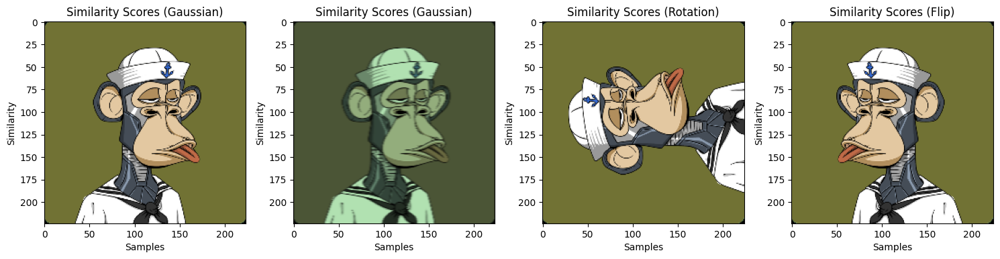

Similarity (Gaussian): ['[[0.99999964]]'], Similarity (Rotation): ['[[0.9999956]]'], Similarity (Flip): ['[[1.]]']


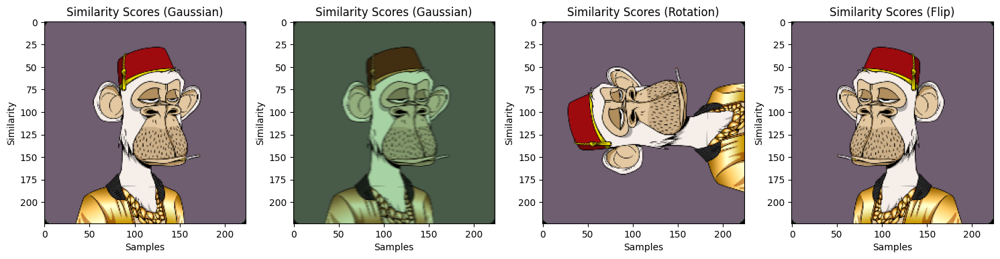

Similarity (Gaussian): ['[[0.99999785]]'], Similarity (Rotation): ['[[0.99999905]]'], Similarity (Flip): ['[[0.999998]]']


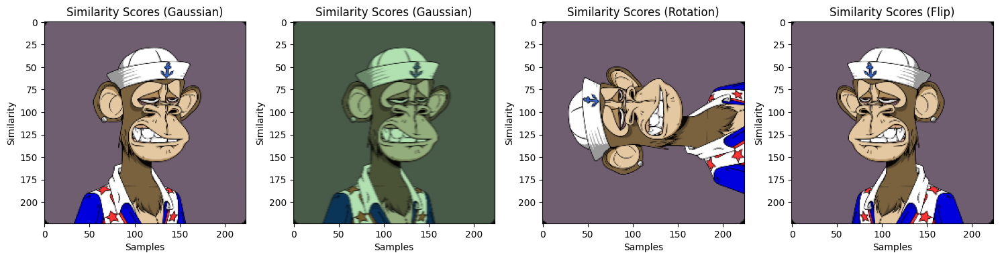

Similarity (Gaussian): ['[[1.]]'], Similarity (Rotation): ['[[0.99999905]]'], Similarity (Flip): ['[[0.9999969]]']


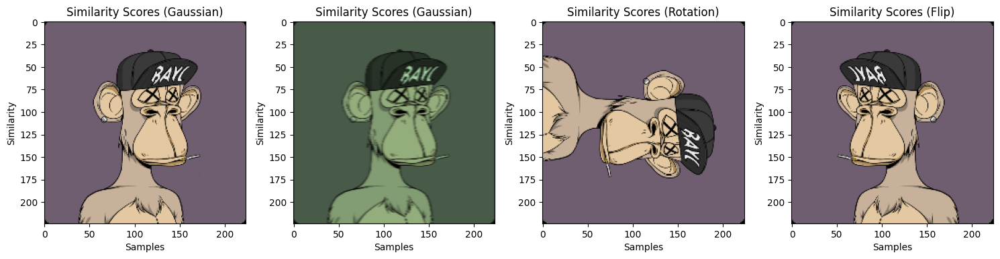

Similarity (Gaussian): ['[[0.99989057]]'], Similarity (Rotation): ['[[0.9999491]]'], Similarity (Flip): ['[[0.9999993]]']


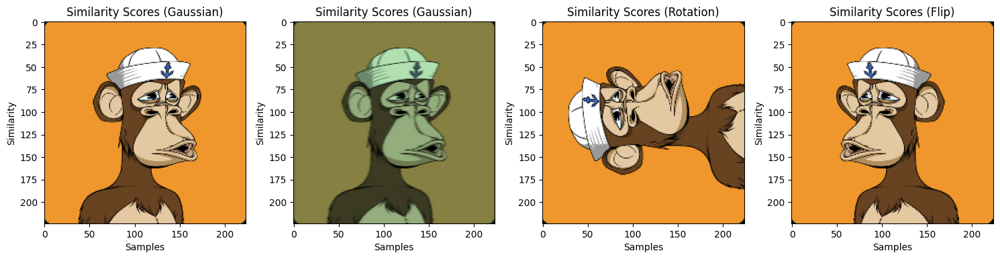

Similarity (Gaussian): ['[[0.9999999]]'], Similarity (Rotation): ['[[0.9999999]]'], Similarity (Flip): ['[[0.999998]]']


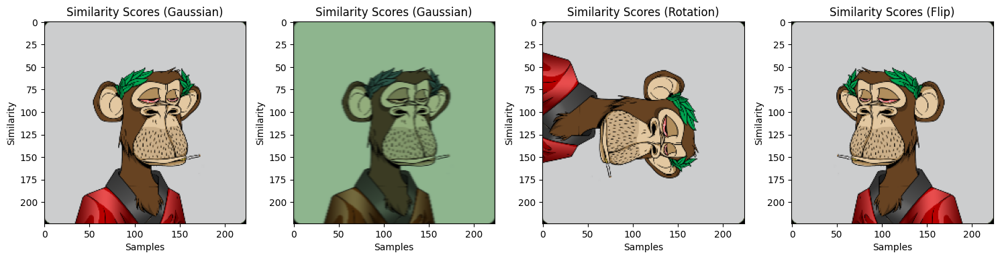

Similarity (Gaussian): ['[[1.]]'], Similarity (Rotation): ['[[0.9999999]]'], Similarity (Flip): ['[[0.9999987]]']


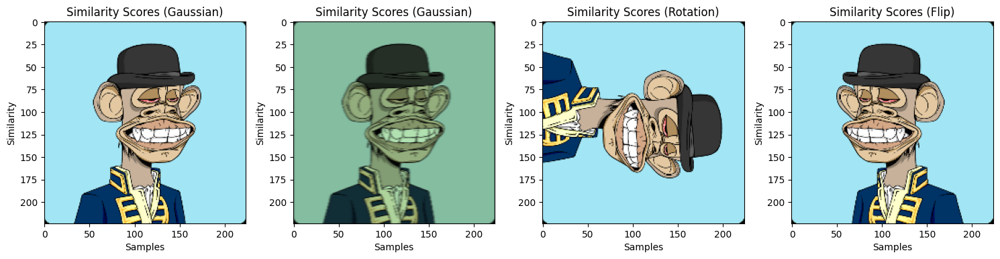

Similarity (Gaussian): ['[[1.]]'], Similarity (Rotation): ['[[0.99999833]]'], Similarity (Flip): ['[[0.99999976]]']


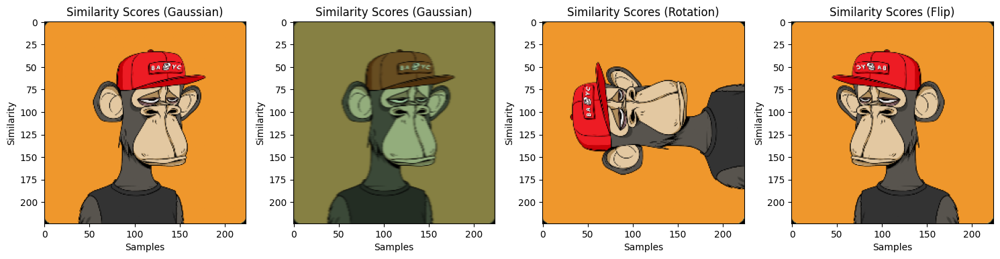

Similarity (Gaussian): ['[[0.99999976]]'], Similarity (Rotation): ['[[0.99999845]]'], Similarity (Flip): ['[[0.9999944]]']


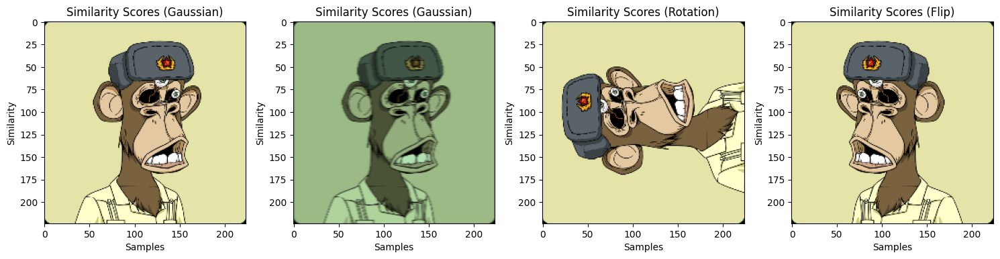

Similarity (Gaussian): ['[[0.9999827]]'], Similarity (Rotation): ['[[1.]]'], Similarity (Flip): ['[[0.9999999]]']


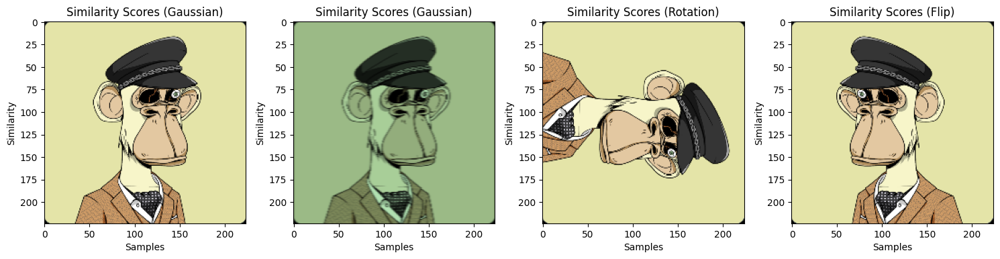

Similarity (Gaussian): ['[[0.99999964]]'], Similarity (Rotation): ['[[0.99999964]]'], Similarity (Flip): ['[[0.9999987]]']


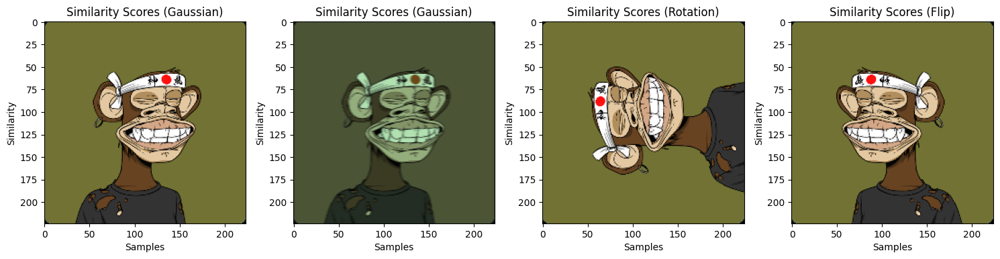

Similarity (Gaussian): ['[[1.]]'], Similarity (Rotation): ['[[0.99999106]]'], Similarity (Flip): ['[[0.9999999]]']


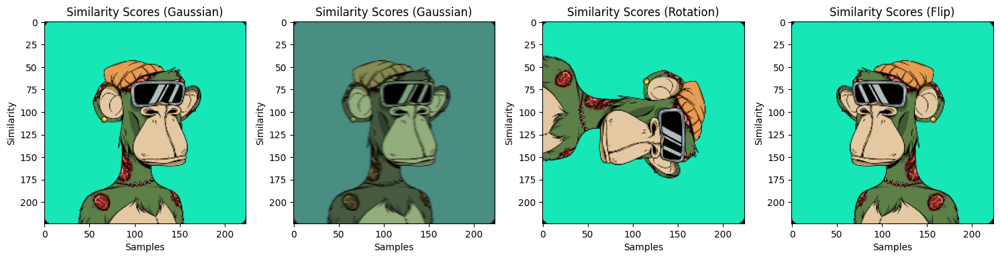

Similarity (Gaussian): ['[[0.9999999]]'], Similarity (Rotation): ['[[0.9999932]]'], Similarity (Flip): ['[[0.9999399]]']


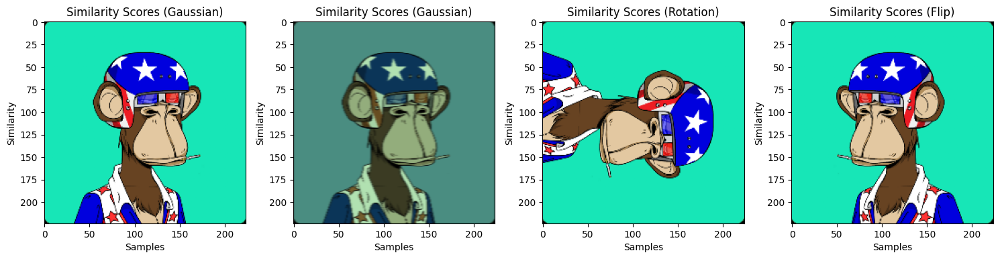

Similarity (Gaussian): ['[[1.]]'], Similarity (Rotation): ['[[1.]]'], Similarity (Flip): ['[[0.99999917]]']


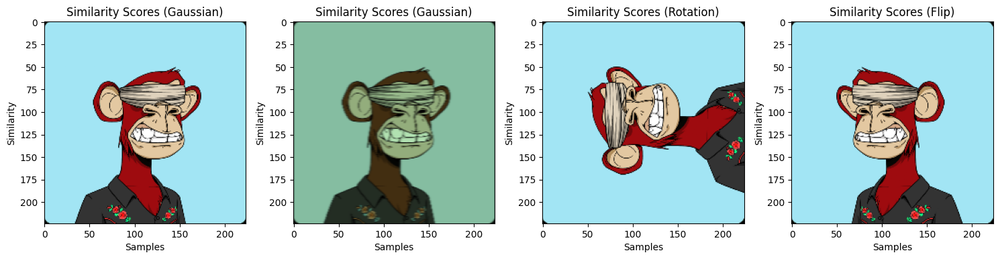

Similarity (Gaussian): ['[[1.]]'], Similarity (Rotation): ['[[0.9999976]]'], Similarity (Flip): ['[[0.99999976]]']


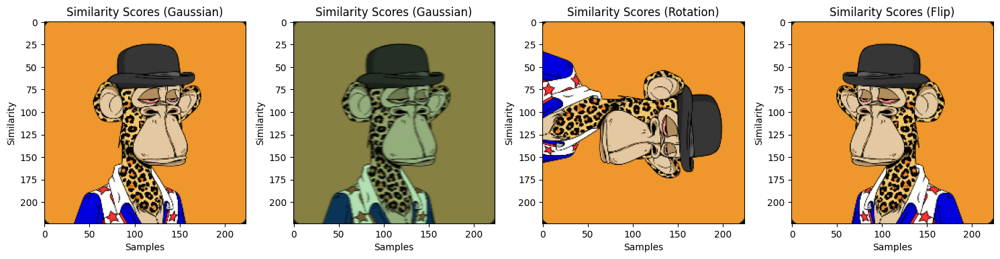

Similarity (Gaussian): ['[[1.]]'], Similarity (Rotation): ['[[1.]]'], Similarity (Flip): ['[[0.99999726]]']


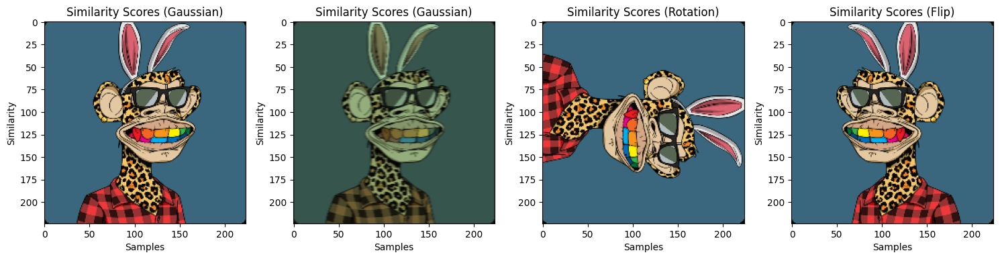

Similarity (Gaussian): ['[[0.9999893]]'], Similarity (Rotation): ['[[1.]]'], Similarity (Flip): ['[[0.9999995]]']


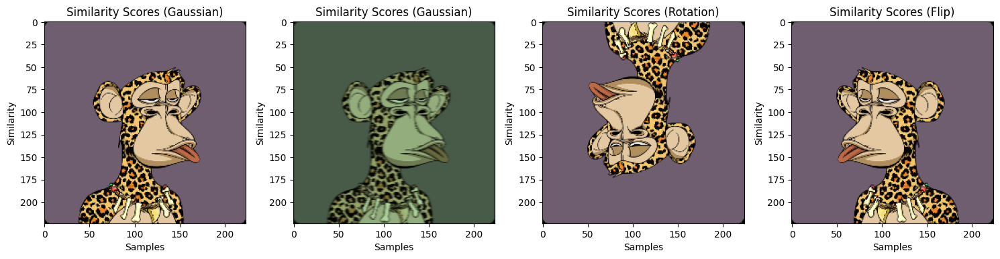

Similarity (Gaussian): ['[[0.9999995]]'], Similarity (Rotation): ['[[1.]]'], Similarity (Flip): ['[[1.]]']


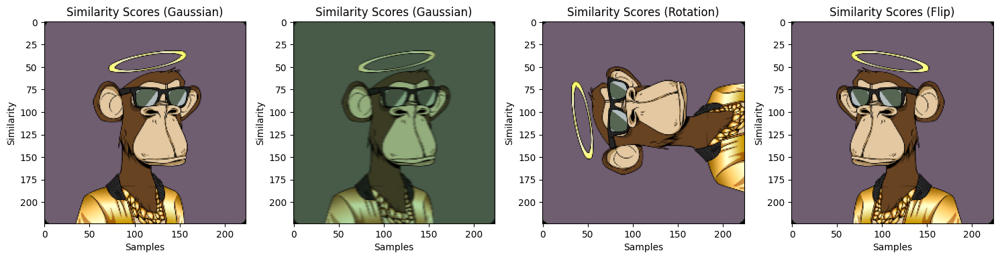

Similarity (Gaussian): ['[[0.99999416]]'], Similarity (Rotation): ['[[0.99999976]]'], Similarity (Flip): ['[[1.]]']


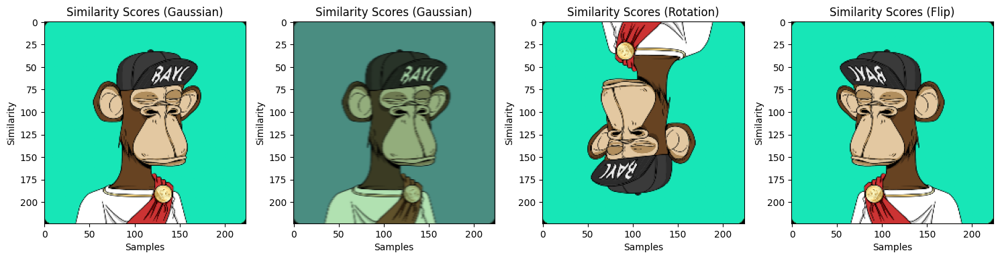

Similarity (Gaussian): ['[[1.]]'], Similarity (Rotation): ['[[0.9999999]]'], Similarity (Flip): ['[[0.99965847]]']


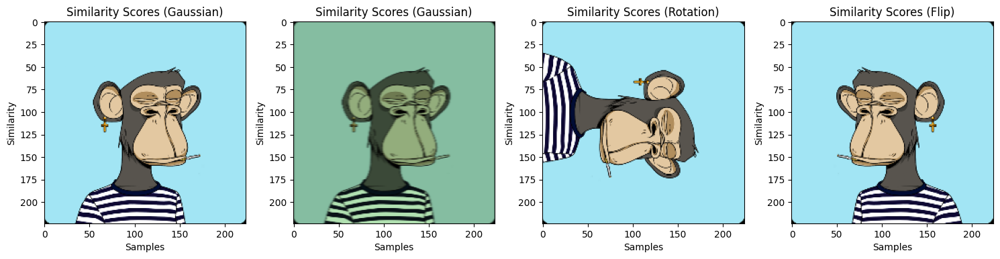

Similarity (Gaussian): ['[[1.]]'], Similarity (Rotation): ['[[1.]]'], Similarity (Flip): ['[[0.9999653]]']


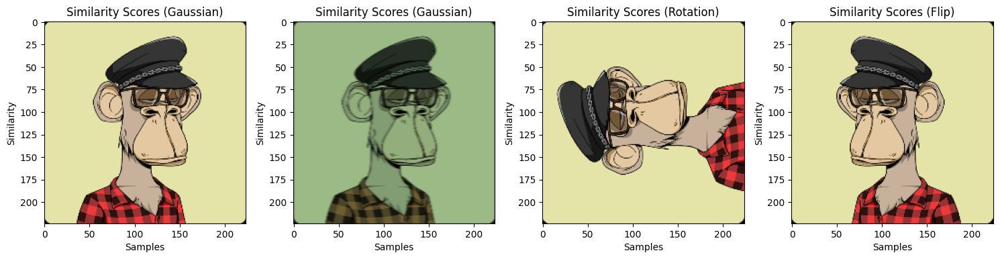

Similarity (Gaussian): ['[[1.]]'], Similarity (Rotation): ['[[0.99999857]]'], Similarity (Flip): ['[[1.]]']


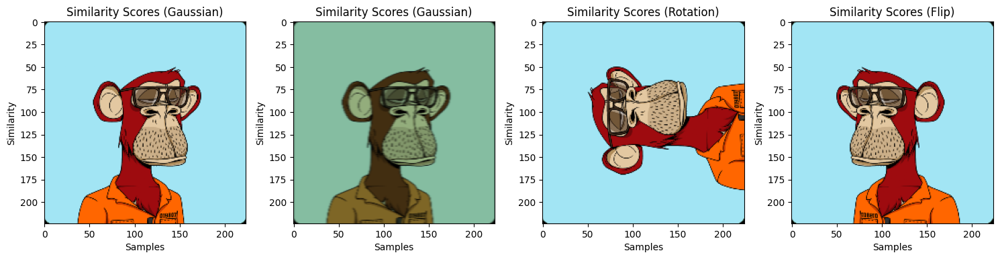

Similarity (Gaussian): ['[[1.]]'], Similarity (Rotation): ['[[0.9999995]]'], Similarity (Flip): ['[[0.9999999]]']


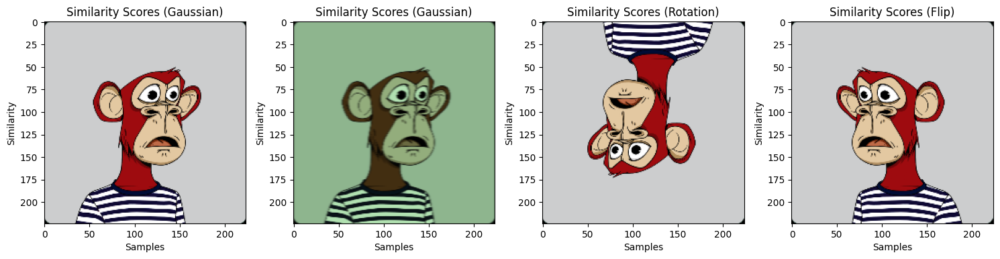

Similarity (Gaussian): ['[[1.]]'], Similarity (Rotation): ['[[1.]]'], Similarity (Flip): ['[[0.99746007]]']


In [ ]:

for url in file_paths:

    fig, axs = plt.subplots(1, 4, figsize=(15, 5))
    row = find_row_by_url(url.split('\\')[-1])

    processed_image1 = preprocess_main_image(url)
    processed_image2 = preprocess_gaussian_image(url)
    processed_image1 = np.expand_dims(processed_image1, axis=0)
    processed_image2 = np.expand_dims(processed_image2, axis=0)
    gaussian_score=row['Similarity (Gaussian)'].values


    axs[0].imshow(processed_image1[0])
    axs[0].set_title('Similarity Scores (Gaussian)')
    axs[0].set_xlabel('Samples')
    axs[0].set_ylabel('Similarity')

    axs[1].imshow(processed_image2[0])
    axs[1].set_title('Similarity Scores (Gaussian)')
    axs[1].set_xlabel('Samples')
    axs[1].set_ylabel('Similarity')


    processed_image1 = preprocess_main_image(url)
    processed_image2 = preprocess_rotation_image(url)
    processed_image1 = np.expand_dims(processed_image1, axis=0)
    processed_image2 = np.expand_dims(processed_image2, axis=0)
    rotation_score=row['Similarity (Flip)'].values


    axs[2].imshow(processed_image2[0])
    axs[2].set_title('Similarity Scores (Rotation)')
    axs[2].set_xlabel('Samples')
    axs[2].set_ylabel('Similarity')



    processed_image1 = preprocess_main_image(url)
    processed_image2 = preprocess_flip_image(url)
    processed_image1 = np.expand_dims(processed_image1, axis=0)
    processed_image2 = np.expand_dims(processed_image2, axis=0)
    flip_score=row['Similarity (Rotation)'].values



    axs[3].imshow(processed_image2[0])
    axs[3].set_title('Similarity Scores (Flip)')
    axs[3].set_xlabel('Samples')
    axs[3].set_ylabel('Similarity')

    plt.tight_layout()  # Adjust layout to prevent overlap
    plt.show()
    print(f"Similarity (Gaussian): {gaussian_score}, Similarity (Rotation): {rotation_score}, Similarity (Flip): {flip_score}")
